In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd
import os, pickle

import sys
sys.path.append('../src')
from models import ModelConstructor
from utils import normalize, calc_rf_indices

# figure settings
DPI=600
plt.rcParams.update({'font.family': 'Arial'})
plt.rcParams.update({'font.size': 20})
plt.rcParams.update({'axes.labelsize': 24})
plt.rcParams.update({'xtick.labelsize': 20})
plt.rcParams.update({'ytick.labelsize': 20})
plt.rcParams.update({'axes.titlesize': 24})
plt.rcParams.update({'axes.titleweight': 'bold'})

# standard (red) and biomimetic (blue) color + v2-v4 colors
colors = np.array([[168, 14, 53], [0, 82, 137], [0, 128, 128], [128, 0, 128], [255, 165, 0]])
colors = colors/255

# constants
IMG_SIZE = (256, 256, 3)
NUM_CLASSES = 1000

#Path Settings
PROJECT_PATH = ".."
MODEL_PATH = os.path.join(PROJECT_PATH, "trained_models", "v1")
RESULT_PATH = os.path.join(PROJECT_PATH, "result", "v1")
FIGURE_PATH = os.path.join(PROJECT_PATH, "figures")
if not os.path.exists(FIGURE_PATH):
    os.mkdir(FIGURE_PATH)

/opt/anaconda3/envs/tf241/lib/python3.8/site-packages/tensorflow_addons/utils/ensure_tf_install.py:53: UserWarning: Tensorflow Addons supports using Python ops for all Tensorflow versions above or equal to 2.6.0 and strictly below 2.9.0 (nightly versions are not supported). 
 The versions of TensorFlow you are currently using is 2.4.1 and is not supported. 
Some things might work, some things might not.
If you were to encounter a bug, do not file an issue.
If you want to make sure you're using a tested and supported configuration, either change the TensorFlow version or the TensorFlow Addons's version. 
You can find the compatibility matrix in TensorFlow Addon's readme:
https://github.com/tensorflow/addons
  warnings.warn(


In [2]:
def get_path(start_path, model_name, train_version, repeat, create=False):
    path = os.path.join(start_path, model_name, str(train_version), str(repeat))
    if create and (not os.path.exists(path)):
        os.makedirs(path)    
    return path

## RF plot functions

In [3]:
def get_rf_indices(model_name, train_version, repeat, regimen_list, n_top_col_pixel=48):
    # get path
    model_path = get_path(MODEL_PATH, model_name, train_version, repeat)

    # construct model
    model = ModelConstructor(model_name=model_name, 
                             input_shape=IMG_SIZE, 
                             num_classes=NUM_CLASSES).getModel()
    # get rf indices
    color_ind_all = []
    fftfreq_ind_all = []
    fftaz_ind_all = []
    norm_weights = []
    for regimen in regimen_list:
        # get weights
        m = os.path.join(model_path, regimen)
        model.load_weights(m).expect_partial()
        w0 = model.layers[4].get_weights()[0]

        # get rf indices
        [color_index, fft_freq_index, fft_az_index] = calc_rf_indices(w0, n_top_col_pixel=n_top_col_pixel)
        color_ind_all.append(color_index)
        fftfreq_ind_all.append(fft_freq_index)
        fftaz_ind_all.append(fft_az_index)
        
        # normalize weights
        w0_norm = np.zeros(w0.shape)
        num_rf = w0.shape[3]
        for i in range(num_rf):
            w0_norm[:,:,:,i] = normalize(w0[:,:,:,i])   
        norm_weights.append(w0_norm)
    
    return color_ind_all, fftfreq_ind_all, fftaz_ind_all, norm_weights

In [4]:
def visualize_rf(w0_norm, index, num_columns, figure_path):
    num_rf = w0_norm.shape[3]
    num_rows = num_rf//num_columns + int(num_rf%num_columns>0)

    fig, axs = plt.subplots(num_rows, num_columns, figsize=(num_columns, num_rows))
    for count, i in enumerate(np.argsort(index)):
        axe = axs[int(count/num_columns), count%num_columns]
        axe.imshow(w0_norm[:,:,:,i])
        axe.set_xticks([])
        axe.set_yticks([])  
    fig.savefig(figure_path, dpi=DPI)

In [5]:
def create_rf_density_plot(regimen_names, color_ind_all, fftfreq_ind_all, 
                           figure_path, freq_range=(1, 11), freq_xlim=(1, 8)):
    fig, ax = plt.subplots(1, 2, figsize=(14, 5.5))
    for j in range(len(regimen_names)):
        sns.kdeplot(color_ind_all[j], ax=ax[0], color=colors[j], clip=(0,1), fill=True)
        sns.kdeplot(fftfreq_ind_all[j], ax=ax[1], color=colors[j], clip=freq_range, fill=True)
        ax[0].set_yticks([])
        ax[1].set_yticks([])

    ax[0].set_xlim([0,1])
    ax[1].set_xlim(freq_xlim)
    ax[0].set_xlabel("Color metric")
    ax[1].set_xlabel("Spatial frequency metric")
    ax[0].set_title("Color tuning")
    ax[1].set_title("Spatial frequency tuning")
    ax[1].legend(regimen_names)

    plt.tight_layout()
    fig.savefig(figure_path, dpi=DPI)

In [6]:
def create_rf_scatterplot(regimen_names, color_ind_all, fftfreq_ind_all, fftaz_ind_all, 
                          figure_path, freq_range=(2, 7.6), col_max=0.82):
    num_regimens = len(regimen_names)
    fig, ax = plt.subplots(1, num_regimens, figsize=(8*num_regimens, 5.5))
    for j in range(num_regimens):
        s = ax[j].scatter(color_ind_all[j], fftfreq_ind_all[j], c=fftaz_ind_all[j], 
                        vmin=0, vmax=0.9, s=100, edgecolors='black', linewidth=0.3)
        plt.colorbar(s, ax=ax[j], ticks=np.arange(0, 1.0, 0.1), 
                    label='Orientation selectivity', pad=0.02)
        ax[j].set_xticks(np.arange(0, col_max, 0.1))
        ax[j].set_xticklabels(["0", "0.1", "0.2", "0.3", "0.4", "0.5", "0.6", "0.7", "0.8"])
        ax[j].set_xlim([0, col_max])
        ax[j].set_ylim(freq_range)
        ax[j].set_xlabel("Color metric")
        ax[j].set_ylabel("Frequency metric")
        ax[j].set_title(regimen_names[j])

    plt.tight_layout()
    fig.savefig(figure_path, dpi=DPI)

In [7]:
def create_rf_plot_merged_repeats(regimen_names, color_ind_all, fftfreq_ind_all, fftaz_ind_all, 
                          figure_path, freq_range=(1, 11), freq_xlim=(1, 8), freq_range2=(2, 7.6), col_max=0.82,
                          scatter_plot_index=0):
    num_repeats = len(color_ind_all)
    num_scatter_plots = len(regimen_names[scatter_plot_index:])
    fig, ax = plt.subplots(num_repeats, 2 + num_scatter_plots, figsize=(17 + 9*num_scatter_plots, 6*num_repeats))
    for i in range(num_repeats):
        for j in range(len(regimen_names)):
            sns.kdeplot(color_ind_all[i][j], ax=ax[i, 0], color=colors[j], clip=(0,1), fill=True)
            sns.kdeplot(fftfreq_ind_all[i][j], ax=ax[i, 1], color=colors[j], clip=freq_range, fill=True)
            ax[i, 0].set_yticks([])
            ax[i, 1].set_yticks([])
        
        ax[i, 0].set_xlim([0, 1])
        ax[i, 1].set_xlim(freq_xlim)
        ax[i, 0].set_xlabel("Color metric")
        ax[i, 1].set_xlabel("Spatial frequency metric")
        ax[i, 0].set_title("Color tuning")
        ax[i, 1].set_title("Spatial frequency tuning")
        ax[i, 1].legend(regimen_names)

        for j in range(num_scatter_plots):
            s = ax[i, j+2].scatter(color_ind_all[i][j+scatter_plot_index], fftfreq_ind_all[i][j+scatter_plot_index], 
                            c=fftaz_ind_all[i][j+scatter_plot_index], vmin=0, vmax=0.9, s=100, 
                            edgecolors='black', linewidth=0.3)
            plt.colorbar(s, ax=ax[i, j+2], ticks=np.arange(0, 1.0, 0.1), 
                         label='Orientation selectivity', pad=0.02)
            ax[i,j+2].set_xticks(np.arange(0, col_max, 0.1))
            ax[i,j+2].set_xticklabels(["0", "0.1", "0.2", "0.3", "0.4", "0.5", "0.6", "0.7", "0.8"])
            ax[i,j+2].set_xlim([0, col_max])
            ax[i,j+2].set_ylim(freq_range2)
            ax[i,j+2].set_xlabel("Color metric")
            ax[i,j+2].set_ylabel("Frequency metric")
            ax[i,j+2].set_title(regimen_names[j+scatter_plot_index])
    
    plt.tight_layout()
    fig.savefig(figure_path, dpi=DPI)

In [8]:
def create_rf_plot_merged_2x2(regimen_names, color_ind_all, fftfreq_ind_all, fftaz_ind_all, 
                              figure_path, freq_range=(1, 11), freq_xlim=(1, 8), freq_range2=(2, 7.6), col_max=0.82):
    fig, ax = plt.subplots(2, 2, figsize=(17, 12))
    for j in range(len(regimen_names)):
        sns.kdeplot(color_ind_all[j], ax=ax[0, 0], color=colors[j], clip=(0,1), fill=True)
        sns.kdeplot(fftfreq_ind_all[j], ax=ax[0, 1], color=colors[j], clip=freq_range, fill=True)
        ax[0, 0].set_yticks([])
        ax[0, 1].set_yticks([])

    ax[0, 0].set_xlim([0,1])
    ax[0, 1].set_xlim(freq_xlim)
    ax[0, 0].set_xlabel("Color metric")
    ax[0, 1].set_xlabel("Spatial frequency metric")
    ax[0, 0].set_title("Color tuning")
    ax[0, 1].set_title("Spatial frequency tuning")
    ax[0, 1].legend(regimen_names)

    for j in range(len(regimen_names)):
        s = ax[1, j].scatter(color_ind_all[j], fftfreq_ind_all[j], c=fftaz_ind_all[j], 
                        vmin=0, vmax=0.9, s=100, edgecolors='black', linewidth=0.3)
        plt.colorbar(s, ax=ax[1, j], ticks=np.arange(0, 1.0, 0.1), 
                    label='Orientation selectivity', pad=0.02)
        ax[1, j].set_xticks(np.arange(0, col_max, 0.1))
        ax[1, j].set_xticklabels(["0", "0.1", "0.2", "0.3", "0.4", "0.5", "0.6", "0.7", "0.8"])
        ax[1, j].set_xlim([0, col_max])
        ax[1, j].set_ylim(freq_range2)
        ax[1, j].set_xlabel("Color metric")
        ax[1, j].set_ylabel("Frequency metric")
        ax[1, j].set_title(regimen_names[j])
    
    plt.tight_layout()
    fig.savefig(figure_path, dpi=DPI)

## Texture vs Shape plot functions

In [9]:
def create_texture_shape_barplot(regimen_list, regimen_names, res_pd_all, figure_path, figsize=(6.5, 4.5), legend=True, res_pd_all_2=None):
    fig, ax = plt.subplots(1, 1, figsize=figsize)
    count_type = ["Correct shape", "Others", "Correct texture"]
    colors = np.array([[80, 80, 80], [0, 82, 190], [0, 120, 45]])
    colors = colors/255

    colors_scatter = np.array([[15, 15, 15], [0, 41, 95], [0, 60, 22]])
    colors_scatter = colors_scatter/255

    num_repeat = len(res_pd_all)
    summary_values = np.zeros((len(regimen_list), 3, num_repeat))
    for j, regimen in enumerate(regimen_list):
        if "v4" in regimen_names[j]:
            res_pd_list = res_pd_all_2
        else:
            res_pd_list = res_pd_all
        for rep, res_pd in enumerate(res_pd_list):
            summary = res_pd[f"color_{regimen}_ablation_0"]
            for value in summary.values:
                if isinstance(value, str):
                    value = eval(value)
                for l in range(3):
                    summary_values[j, l, rep] = summary_values[j, l, rep] + value[l]

            summary_values[j, :, rep] = summary_values[j, :, rep]/np.sum(summary_values[j, :, rep])

    summary_mean = np.mean(summary_values, axis=2)
    summary_ste = np.std(summary_values, axis=2)/np.sqrt(num_repeat)

    x = np.arange(len(regimen_names))
    width = 0.25
    gap = 0.05

    # Add bars and scatter points
    for i, pos in zip([0, 2], [-width/2 - gap/2, width/2 + gap/2]):
        ax.bar(x + pos, summary_mean[:, i], width, yerr=summary_ste[:, i], color=colors[i], 
            ecolor='black', capsize=10, error_kw = {'elinewidth': 3}, label=count_type[i])
        for j in range(len(regimen_names)):
            ax.scatter(np.repeat(x[j] + pos, num_repeat) + np.random.normal(0, 0.05, num_repeat),
                       summary_values[j, i, :], color=colors_scatter[i], alpha=0.75, s=30)
            
    # Print the values for others
    for i in range(len(regimen_names)):
        print(regimen_names[i] + ": " + str(summary_mean[i, 1]))

    ax.set_ylim([0, 0.4])
    ax.set_xticks(x)
    ax.set_xticklabels(regimen_names)
    ax.set_yticks([0, 0.1, 0.2, 0.3, 0.4])
    ax.set_yticklabels([0, 10, 20, 30, 40])
    ax.set_ylabel("Total classifications (%)")
    ax.set_xlabel("Training regimen")
    if legend:
        ax.legend(fontsize=13)

    plt.tight_layout()
    fig.savefig(figure_path, dpi=DPI)

In [10]:
def create_texture_shape_scatterplot(regimen_list, regimen_names, colors, res_pd_all, figure_path, res_pd_all_2=None):
    fig, ax = plt.subplots(1,1, figsize=(7, 7))
    summary_values_all = []

    num_repeat = len(res_pd_all)

    category_names = res_pd_all[0].index.str.capitalize()
    summary_values_all = np.zeros((len(regimen_list), num_repeat, len(category_names)))
    for j, regimen in enumerate(regimen_list):
        if "v4" in regimen_names[j]:
            res_pd_list = res_pd_all_2
        else:
            res_pd_list = res_pd_all
        for rep, res_pd in enumerate(res_pd_list):
            summary = res_pd[f"color_{regimen}_ablation_0"]
            for i, value in enumerate(summary.values):
                if isinstance(value, str):
                    value = eval(value)
                summary_values_all[j, rep, i] = value[0] / (value[0] + value[2])

    summary_mean = np.mean(summary_values_all, axis=1)
    order = np.flip(np.argsort(summary_mean[0]))

    ax.axvline(x=0.5, color='gray', linestyle='--', alpha=0.5)
    y_shift = 0.2  # Shift between regimens
    for i in range(len(regimen_list)):
        shifted_positions = np.arange(len(category_names)) + i * y_shift
        for j in range(num_repeat):
            ax.scatter(summary_values_all[i, j, order], shifted_positions, color=colors[i], marker='o', s=10, alpha=0.75)
        ax.scatter(summary_mean[i, order], shifted_positions, color=colors[i], marker="|", s=350, linewidth=3, label=regimen_names[i])

    ax.set_xlabel("")
    ax.set_xlim([-0.025, 1.025])
    ax.set_xticks([0, 0.25, 0.5, 0.75, 1])
    ax.set_xticklabels([0, 25, 50, 75, 100], fontsize=16)
    ax.set_yticks(np.arange(len(category_names)) + (len(regimen_list)-1) * y_shift/2)
    ax.set_yticklabels(category_names[order], fontsize=16)
    ax.legend(prop={'size': 13})
    ax.set_xlabel("Shape-based, not texture-based, correct decisions (%)", fontsize=16)
    
    plt.tight_layout()
    fig.savefig(figure_path, dpi=DPI)

In [11]:
def create_texture_shape_ablation_plot(regimen_list, regimen_names, res_pd_all, num_max_ablations, figure_path, res_pd_all_2=None):
    ranking_indices = ["color", "color_reverse", "fft_freq", "fft_freq_reverse"]
    ranking_names = ["Low-color", "High-color", "Low-freq", "High-freq"]

    fig, ax = plt.subplots(len(regimen_list), len(ranking_indices), 
                           figsize=(4.5 * len(ranking_indices), 6 * len(regimen_list)))
    count_type = ["Shape", "Others", "Texture"]
    colors = np.array([[80, 80, 80], [0, 82, 190], [0, 120, 45]])
    colors = colors/255
    
    for i, ranking_index in enumerate(ranking_indices):
        for j, regimen in enumerate(regimen_list):
            ax[j, i].plot([0, num_max_ablations], [1/16, 1/16], color='gray', 
                          linewidth=3, linestyle='--', alpha=0.5)
            
            if "v4" in regimen_names[j]:
                res_pd_list = res_pd_all_2
            else:
                res_pd_list = res_pd_all

            rep_all = np.zeros((len(res_pd_list), num_max_ablations+1, 3))
            for rep, res_pd in enumerate(res_pd_list):
                summary_values = np.zeros((num_max_ablations+1, 3))
                for k in range(num_max_ablations+1):
                    summary = res_pd[f"{ranking_index}_{regimen}_ablation_{k}"]
                    for value in summary.values:
                        if isinstance(value, str):
                            value = eval(value)
                        for l in range(3):
                            summary_values[k, l] = summary_values[k, l] + value[l]

                for idx in [0, 2]:
                    ax[j, i].plot(range(num_max_ablations+1), summary_values[:, idx]/sum(summary_values[0,:]),
                            linestyle='-', label=count_type[idx], linewidth=1, c=colors[idx], alpha=0.5)
                    rep_all[rep, :, idx] = summary_values[:, idx]/sum(summary_values[0,:])

            rep_mean = np.mean(rep_all, axis=0)
            for idx in [0, 2]:
                ax[j, i].plot(range(num_max_ablations+1), rep_mean[:, idx],
                        linestyle='-', label=count_type[idx], linewidth=4, c=colors[idx])
                
            ax[j, i].set_ylim([0, 0.4])
            ax[j, i].set_xlim([0, num_max_ablations])
            if num_max_ablations == 48:
                ax[j, i].set_xticks([0, 12, 24, 36, 48])
            elif num_max_ablations == 96:
                ax[j, i].set_xticks([0, 24, 48, 72, 96])
            else:
                raise ValueError("num_max_ablations must be 48 or 96")
            ax[j, i].set_xticklabels([0, 25, 50, 75, 100])
            ax[j, i].set_yticks([0, 0.10, 0.20, 0.30, 0.40])
            ax[j, i].set_yticklabels([0, 10, 20, 30, 40])
            ax[j, i].set_xlabel("RF ablated (%)")
            ax[j, i].set_ylabel("Total classifications (%)")
            ax[j, i].set_title(f"{regimen_names[j]} {ranking_names[i]} abl", fontsize=15)

    plt.tight_layout()
    plt.show()
    fig.savefig(figure_path, dpi=DPI)

# Figure 1

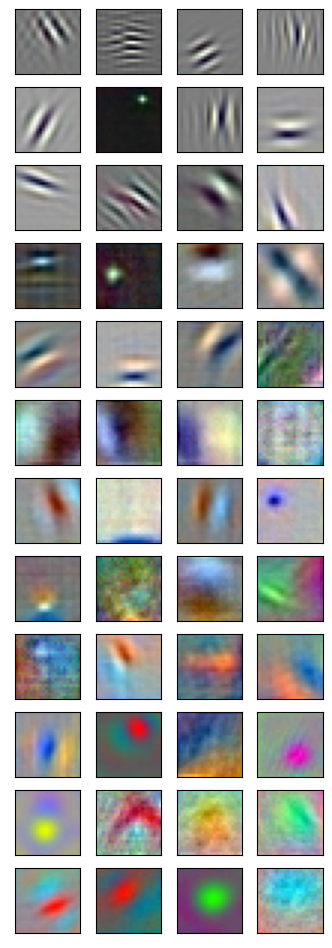

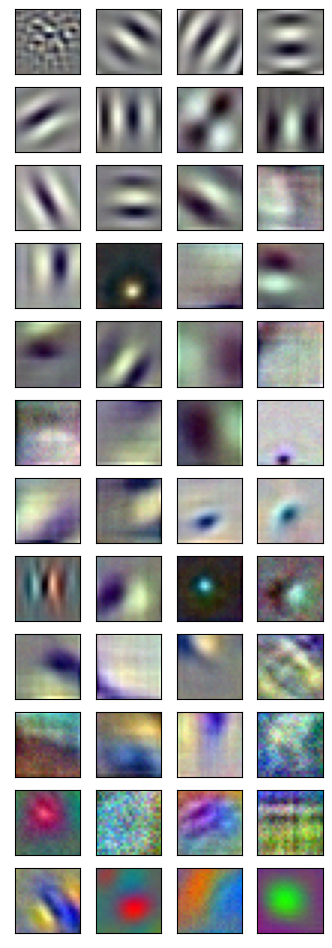

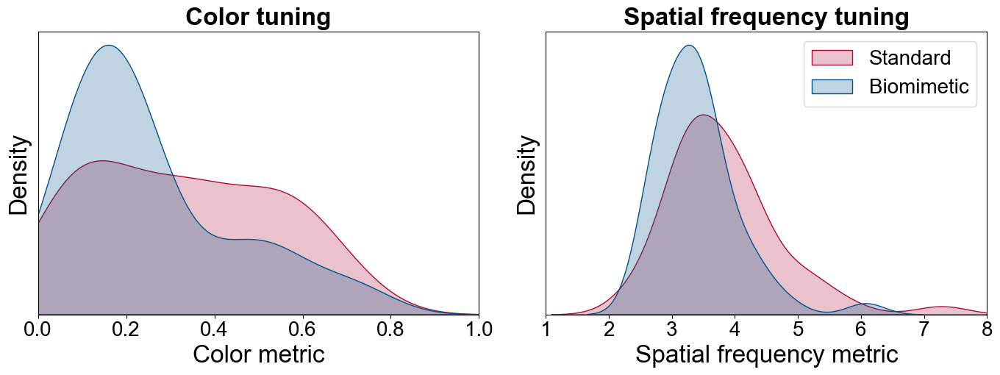

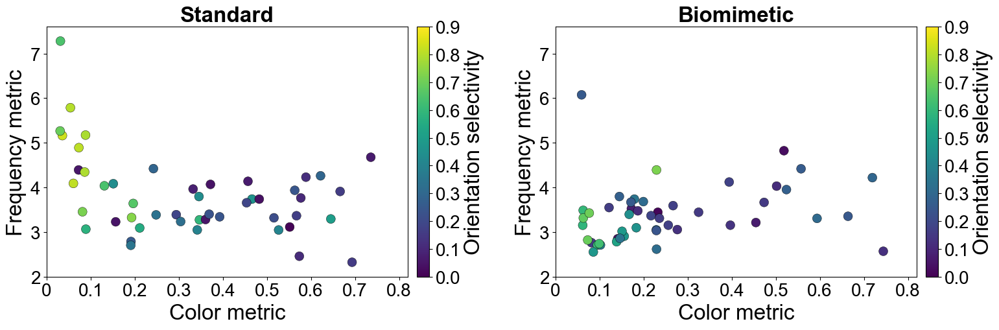

In [12]:
model_name = "alexnet22_48"
train_version = 0
repeat = 0
figure_path = os.path.join(FIGURE_PATH, model_name, str(train_version))
if not os.path.exists(figure_path):
    os.makedirs(figure_path)

regimen_list = ["c0-100_c0-100", "g4-100_c0-100"]
regimen_names = ["Standard", "Biomimetic"]
fig_names = ["Fig1A", "Fig1B"]

color_ind_all, fftfreq_ind_all, fftaz_ind_all, weights_all = get_rf_indices(model_name, train_version, repeat, regimen_list)
for i, regimen in enumerate(regimen_list):
    visualize_rf(weights_all[i], color_ind_all[i], 4, os.path.join(figure_path, fig_names[i] + ".png"))
create_rf_density_plot(regimen_names, color_ind_all, fftfreq_ind_all, os.path.join(figure_path, "Fig1CD.png"))
create_rf_scatterplot(regimen_names, color_ind_all, fftfreq_ind_all, fftaz_ind_all, os.path.join(figure_path, "Fig1EF.png"))


# Figure 2


Standard: 0.5688333333333333
Biomimetic: 0.5894999999999999


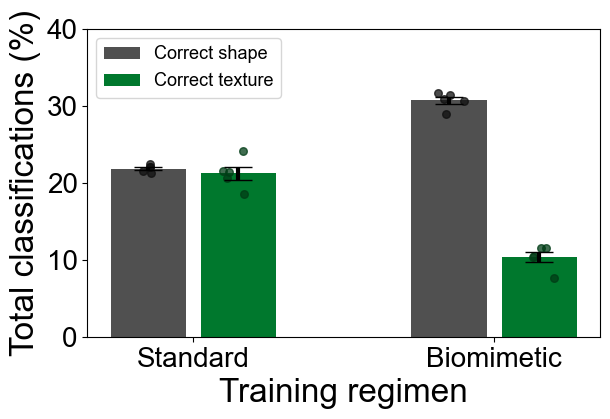

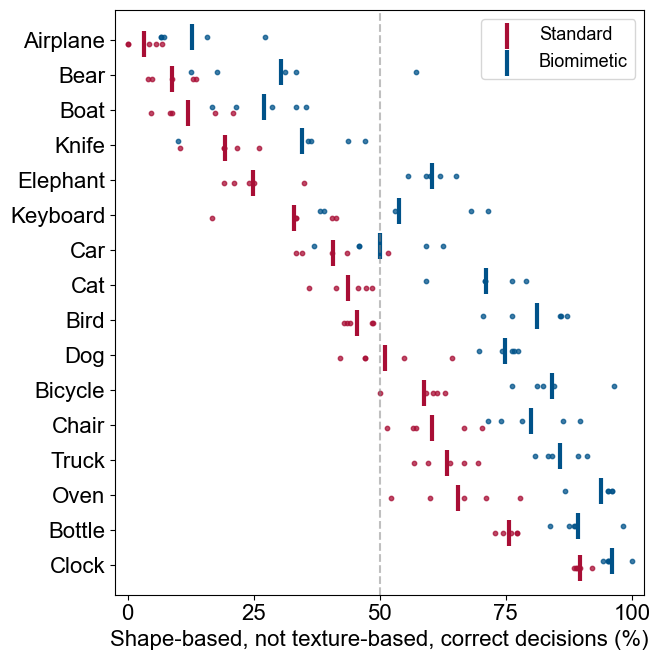

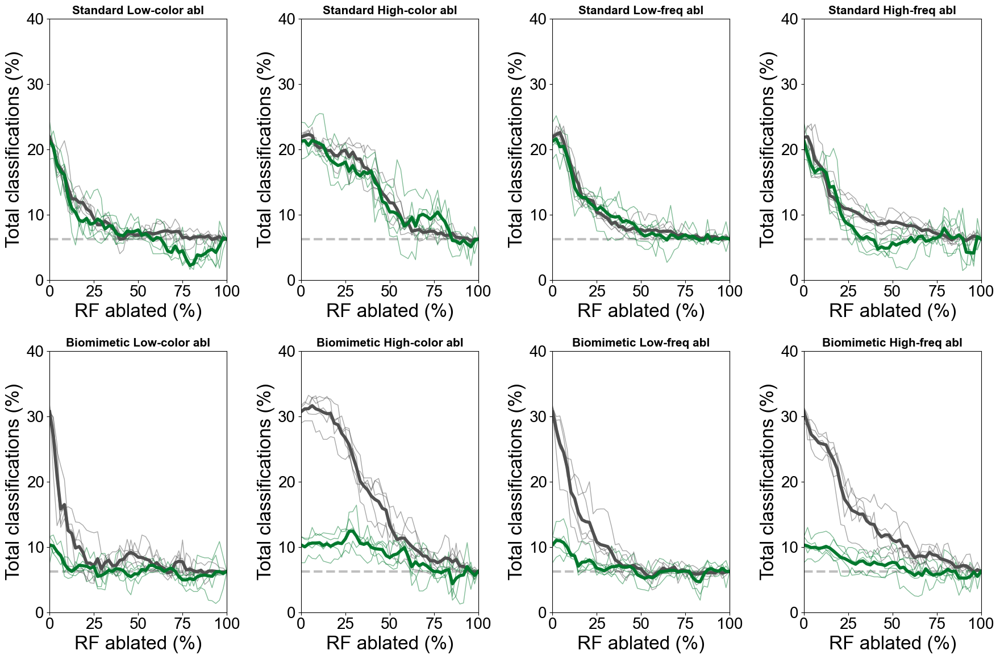

In [13]:
model_name = "alexnet22_48"
train_version = 0
num_max_ablations = 48
regimen_list = ["c0-100_c0-100", "g4-100_c0-100"]
regimen_names = ["Standard", "Biomimetic"]

figure_path = os.path.join(FIGURE_PATH, model_name, str(train_version))
if not os.path.exists(figure_path):
    os.makedirs(figure_path)

res_pd_all = [] 
for i in range(5):
    res_pd_all.append(pd.read_csv(os.path.join(RESULT_PATH, model_name, str(train_version), str(i), "texture_ablation.csv"), index_col=0))

create_texture_shape_barplot(regimen_list, regimen_names, res_pd_all, os.path.join(figure_path, "Fig2B.png"))
create_texture_shape_scatterplot(regimen_list, regimen_names, colors, res_pd_all, os.path.join(figure_path, "Fig2C.png"))
create_texture_shape_ablation_plot(regimen_list, regimen_names, res_pd_all, num_max_ablations, os.path.join(figure_path, "Fig2DE.png"))

# Figure 3

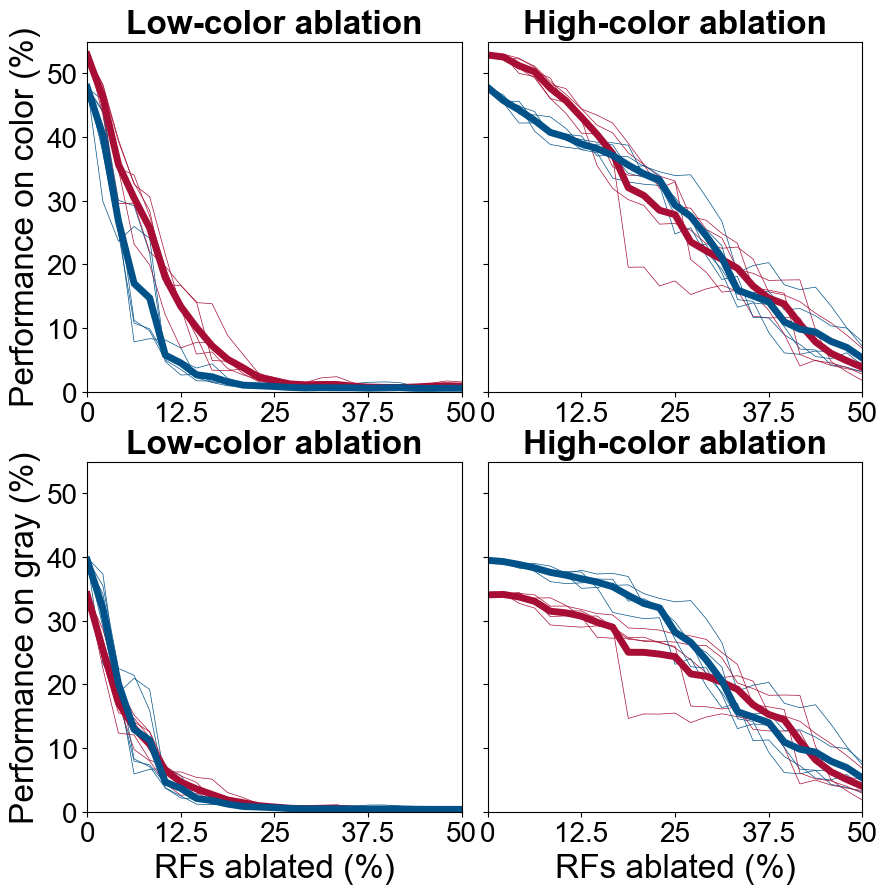

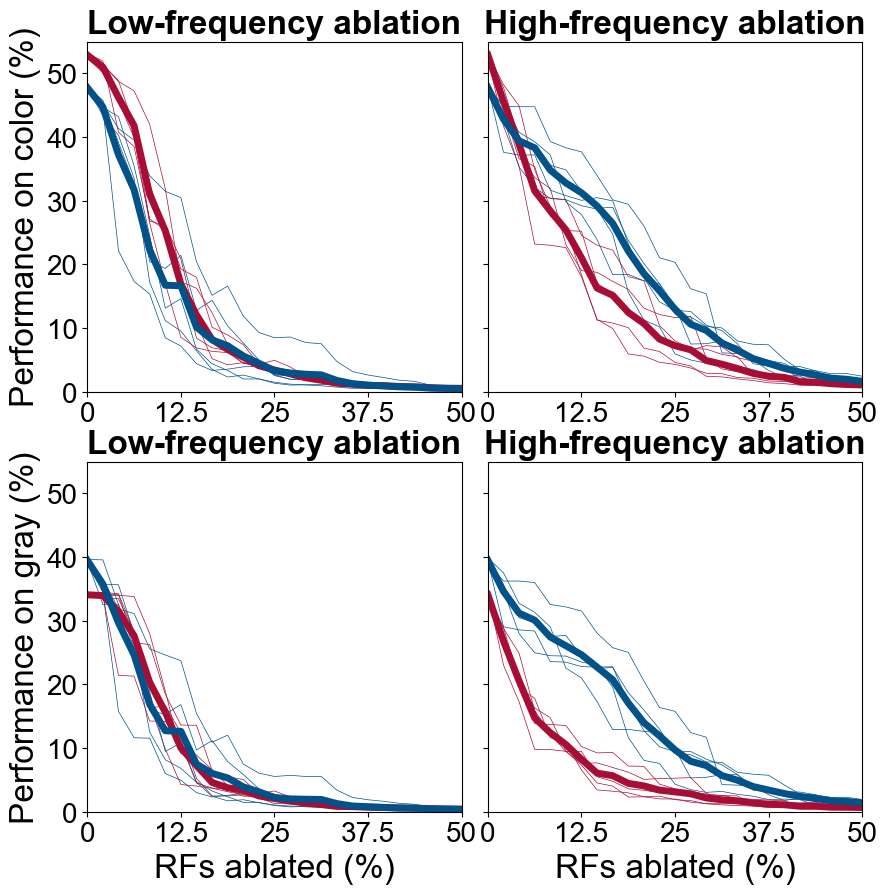

In [14]:
model_name = "alexnet22_48"
train_version = 0

figure_path = os.path.join(FIGURE_PATH, model_name, str(train_version))
if not os.path.exists(figure_path):
    os.makedirs(figure_path)

ranking_indices_all = [["color", "color_reverse"], ["fft_freq", "fft_freq_reverse"]]
indices_names_all = [["Low-color ablation", "High-color ablation"], 
                     ["Low-frequency ablation", "High-frequency ablation"]]
fig_names = ["Fig3A", "Fig3B"]

list_regimens = ["c0-100_c0-100", "g4-100_c0-100"]

num_repeats = 5
num_ablation = 25

for ranking_indices, indices_names, fig_name in zip(ranking_indices_all, indices_names_all, fig_names):
    performance_all = np.zeros((len(list_regimens), len(ranking_indices), 2, num_ablation, num_repeats))
    fig, ax = plt.subplots(2, 2, figsize=(10, 10))
    for repeat in range(num_repeats):
        result_path = get_path(RESULT_PATH, model_name, train_version, repeat)
        top1_path = os.path.join(result_path, "ablation_performance.csv")
        res = pd.read_csv(top1_path, index_col=0)

        for i, ranking_index in enumerate(ranking_indices):
            for j, test_color in enumerate(["col", "gra"]):
                for k, regimen in enumerate(list_regimens):
                    performance = res[regimen + "_" + ranking_index + "_" + test_color]
                    performance_all[k, i, j, :, repeat] = performance
                    ax[j, i].plot(performance, label=regimen, linewidth=0.5, c=colors[k])

                ax[j,i].set_title(indices_names[i])
                ax[j,i].set_xlim(0, 24)
                ax[j,i].set_ylim(0, 0.55)
                ax[j,i].set_xticks([0, 6, 12, 18, 24])
                ax[j,i].set_xticklabels([0, 12.5, 25, 37.5, 50])
                ax[j,i].set_yticks([0, 0.1, 0.2, 0.3, 0.4, 0.5])
                
                if i % 2 == 1:
                    ax[j,i].set_yticklabels([])
                else:
                    ax[j,i].set_yticklabels([0, 10, 20, 30, 40, 50])
                
            ax[1,i].set_xlabel("RFs ablated (%)")
            
            if i % 2 == 0:
                ax[0,i].set_ylabel("Performance on color (%)")
                ax[1,i].set_ylabel("Performance on gray (%)")
            else:
                ax[0,i].set_ylabel("")
                ax[1,i].set_ylabel("")

    performance_mean = np.mean(performance_all, axis=4)
    for i, ranking_index in enumerate(ranking_indices):
        for j, test_color in enumerate(["col", "gra"]):
            for k, regimen in enumerate(list_regimens):
                ax[j, i].plot(performance_mean[k, i, j, :], label=regimen, linewidth=5, c=colors[k])
                
    plt.subplots_adjust(wspace=0.07)
    fig.savefig(os.path.join(figure_path, fig_name + ".png"), dpi=DPI)


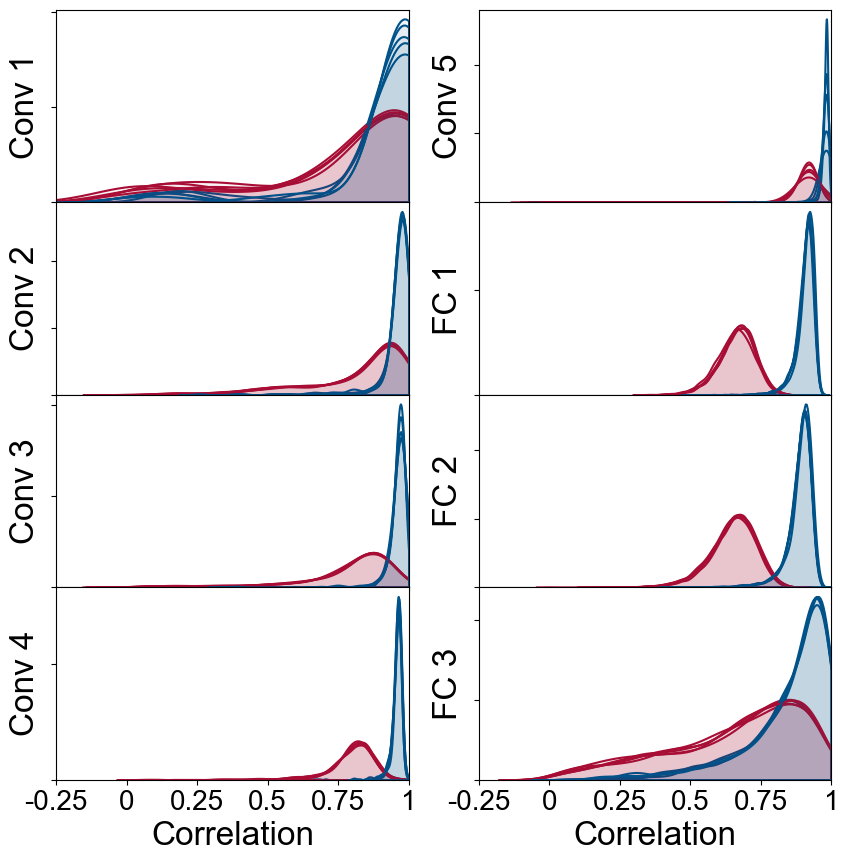

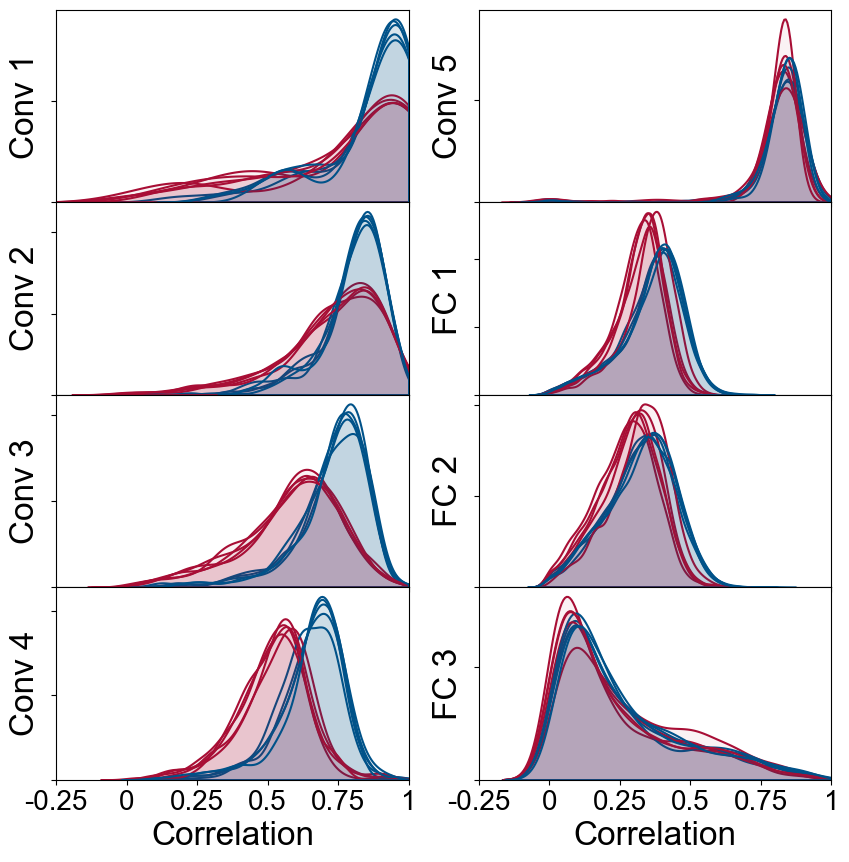

In [15]:
list_files = ["c0_g0", "c0_c4"]
fig_names = ["Fig3C", "Fig3D"]

# Plot settings
kwargs = dict(clip=(-1,1), bw_adjust=1, linewidth=1.5, alpha=0.05)
list_layers = ["Conv 1", "Conv 2", "Conv 3", "Conv 4", "Conv 5", 
               "FC 1", "FC 2", "FC 3"]

# Create plots for each file
for k, name in enumerate(list_files):
    fig, ax = plt.subplots(4, 2, figsize=(10, 10))
    
    # Load and plot correlations for all repeats
    for repeat in range(num_repeats):
        result_path = get_path(RESULT_PATH, model_name, train_version, repeat)
        correlations_path = os.path.join(result_path, "correlations")
        
        for i, regimen in enumerate(list_regimens):
            correlations = pickle.load(open(os.path.join(correlations_path, f"corr_{regimen}_{name}.pkl"), "rb"))
            for j in range(8):  # 8 layers total
                row, col = j%4, j//4
                
                # Plot distribution
                sns.kdeplot(correlations[j], ax=ax[row,col],
                           color=colors[i], fill=True, **kwargs)
                
                # Format axes
                ax[row,col].set_xlim([-0.25, 1])
                ax[row,col].set_xticklabels([])
                ax[row,col].set_yticklabels([])
                ax[row,col].set_ylabel(list_layers[j])
                
                # Add x-axis labels for bottom plots
                if row == 3:
                    ax[row,col].set_xlabel("Correlation")
                    ax[row,col].set_xticks([-0.25, 0, 0.25, 0.5, 0.75, 1])
                    ax[row,col].set_xticklabels([-0.25, 0, 0.25, 0.5, 0.75, 1])

    plt.subplots_adjust(wspace=0.2, hspace=0)
    fig.savefig(os.path.join(figure_path, fig_names[k] + ".png"), dpi=DPI)

# Supplementary Figures

## RF plots

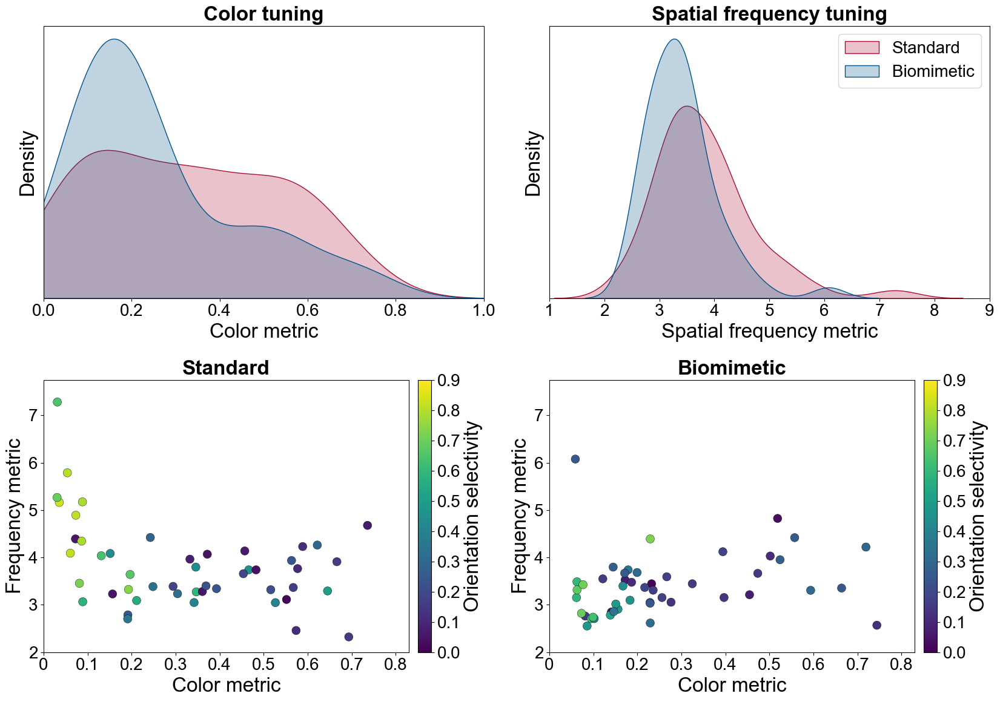

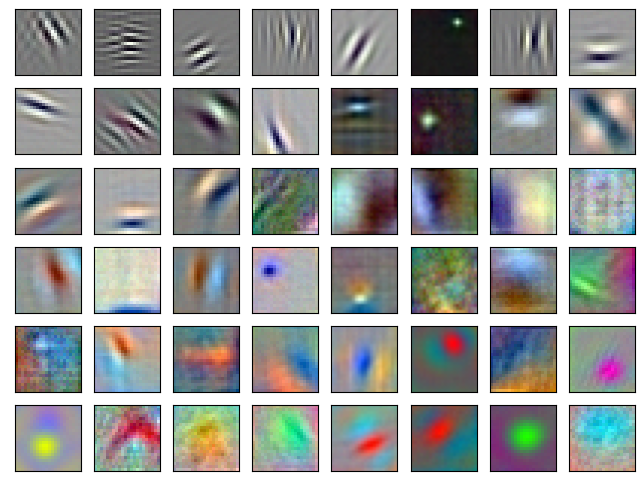

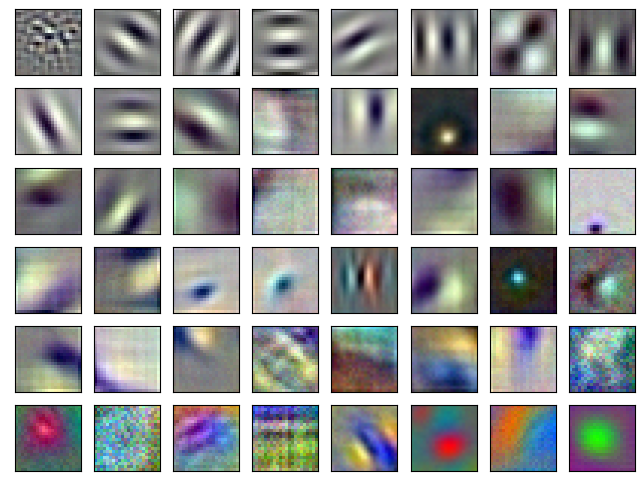

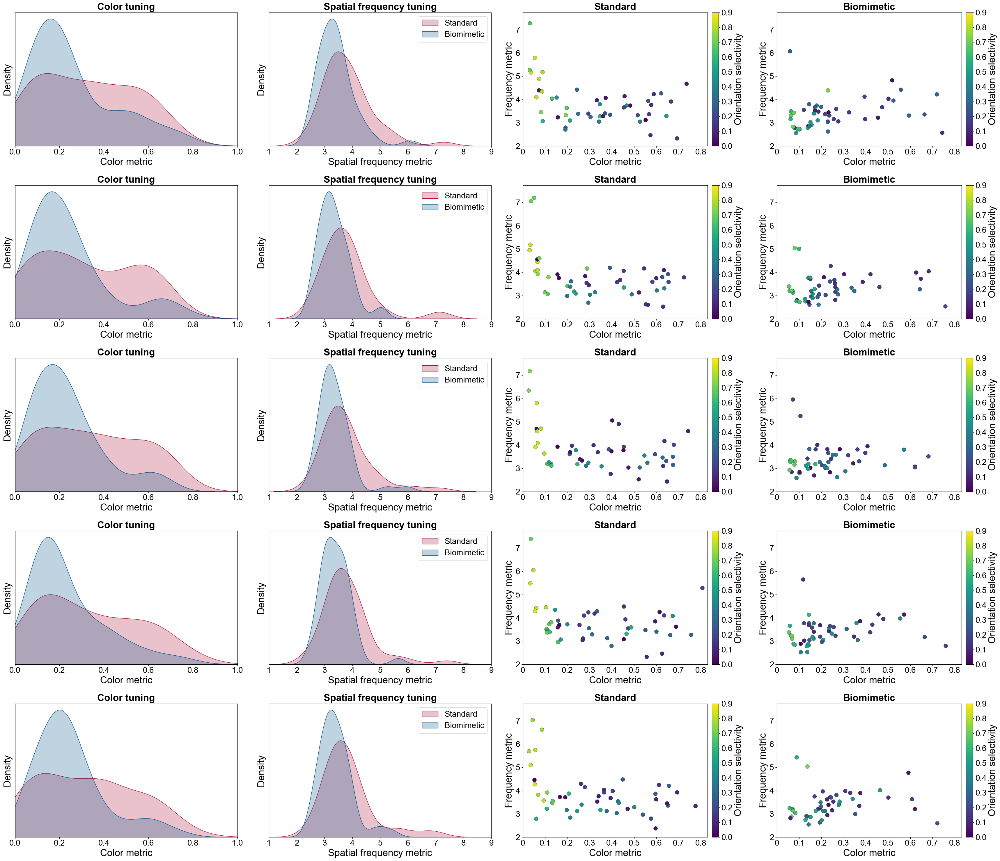

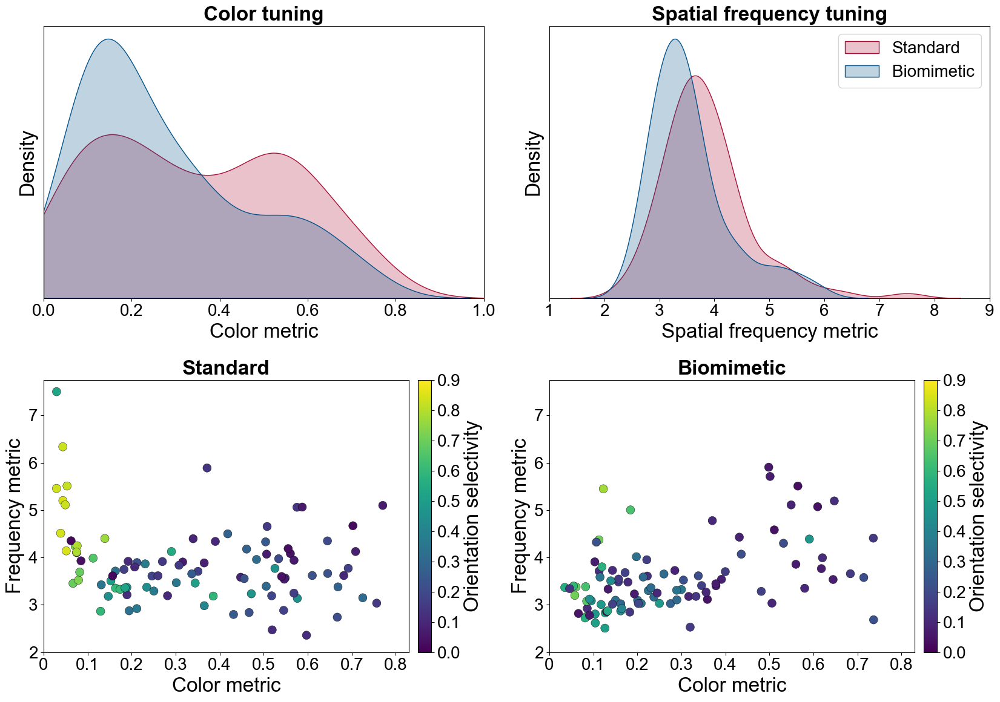

...

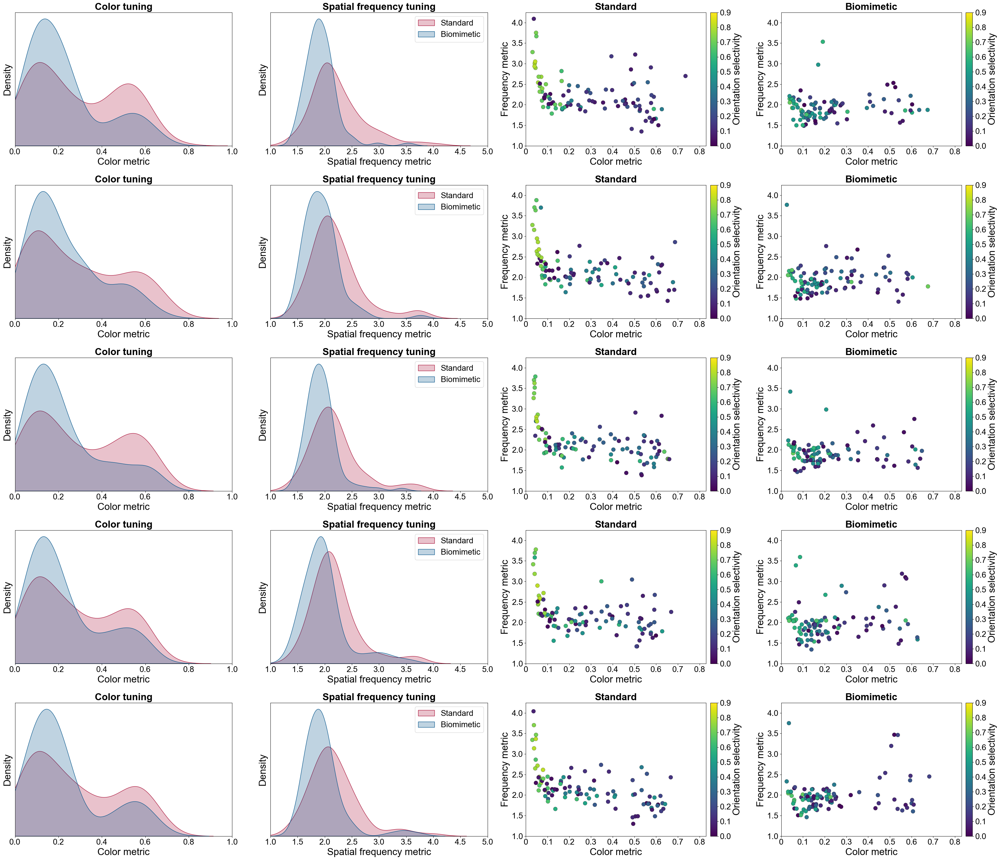

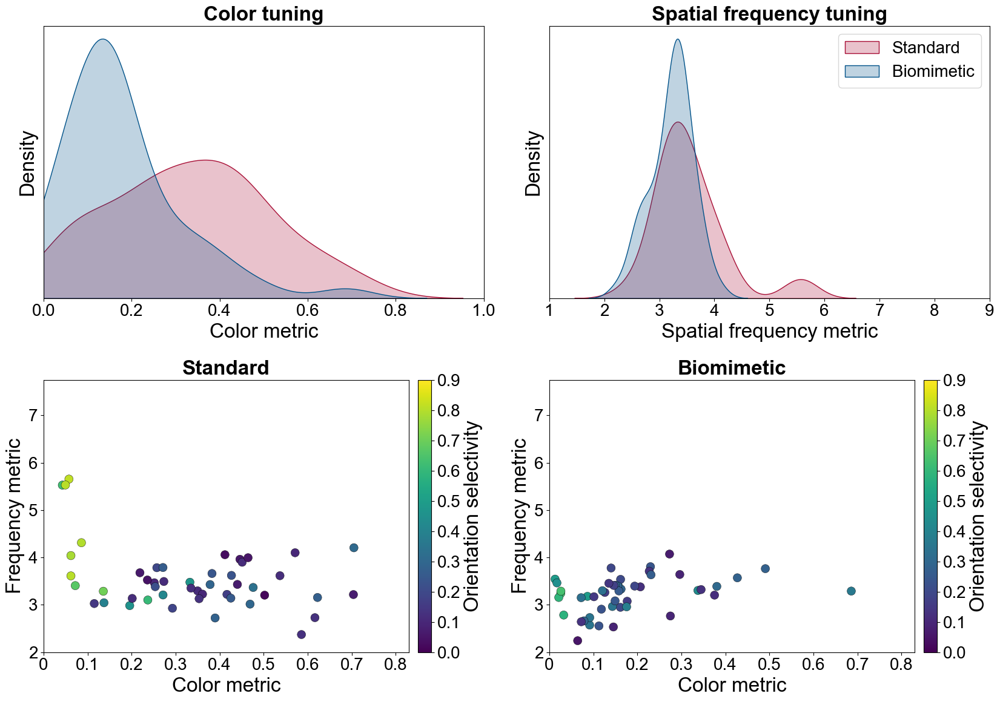

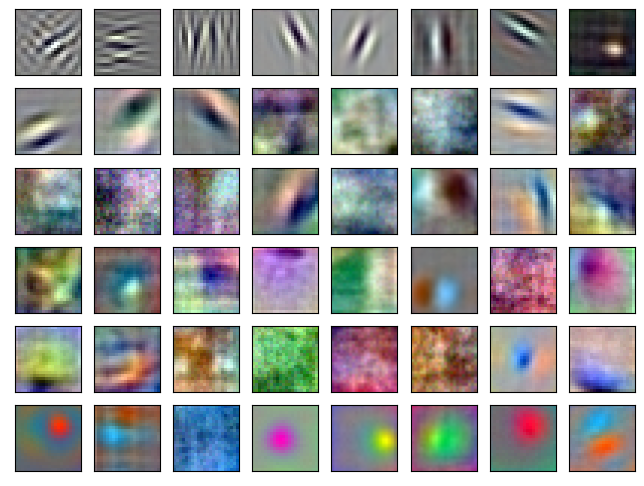

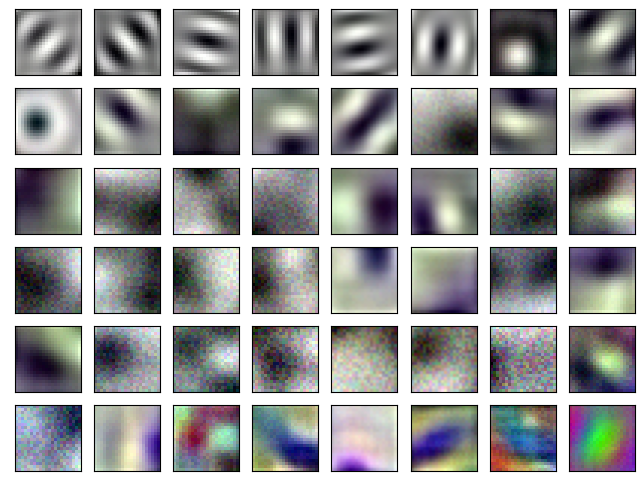

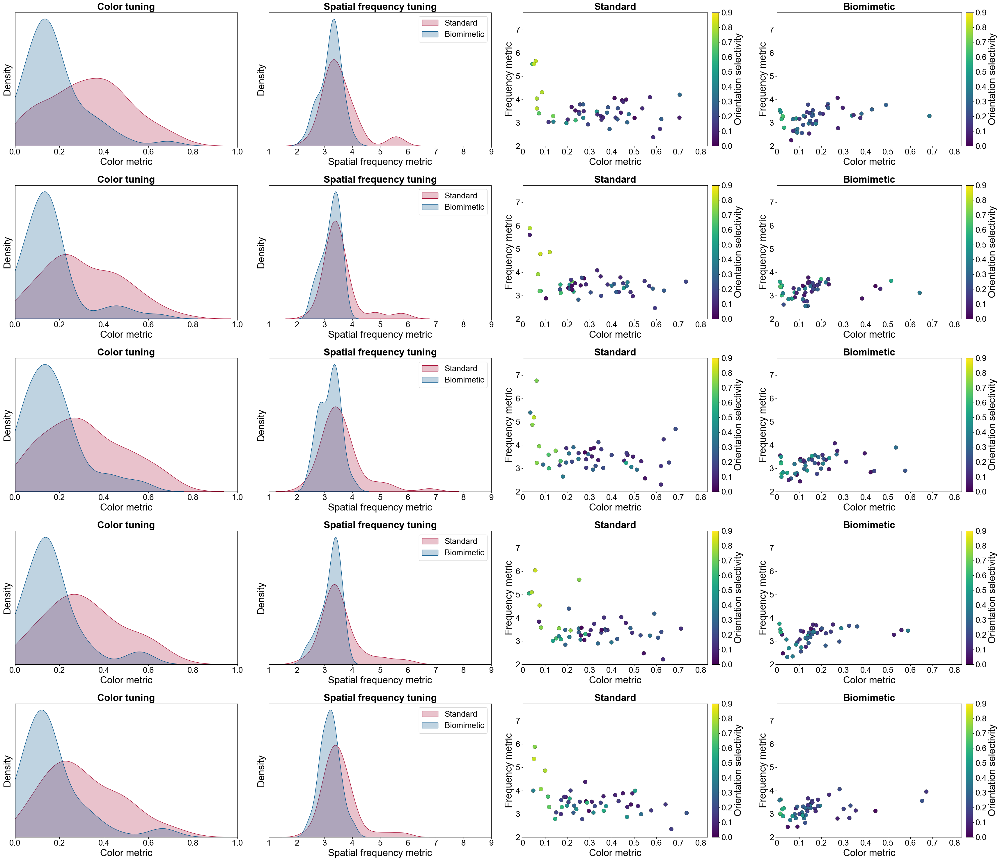

In [16]:
regimen_list = ["c0-100_c0-100", "g4-100_c0-100"]
regimen_names = ["Standard", "Biomimetic"]

model_names = ["alexnet22_48", "alexnet22", "alexnet", "alexnet22_48"]
train_versions = [0, 0, 0, 1]
num_columns = [8, 12, 12, 8]

for model_name, train_version, num_columns in zip(model_names, train_versions, num_columns):
    if model_name == "alexnet":
        freq_xlim = (1, 5)
        freq_range2 = (1, 4.25)
    else:
        freq_xlim = (1, 9)
        freq_range2 = (2, 7.75)
    
    figure_path = os.path.join(FIGURE_PATH, model_name, str(train_version))
    if not os.path.exists(figure_path):
        os.makedirs(figure_path)
    color_ind_all = []
    fftfreq_ind_all = []
    fftaz_ind_all = []
    for repeat in range(5):
        color_ind, fftfreq_ind, fftaz_ind, weights = get_rf_indices(model_name, train_version, repeat, regimen_list)
        if repeat == 0:
            create_rf_plot_merged_2x2(regimen_names, color_ind, fftfreq_ind, fftaz_ind, 
                                      os.path.join(figure_path, "RF_stats_plot_repeat_0_2x2.png"), 
                                      freq_xlim=freq_xlim, freq_range2=freq_range2, col_max=0.83)
            for i, regimen in enumerate(regimen_list):
                visualize_rf(weights[i], color_ind[i], num_columns, os.path.join(figure_path, "RF_" + regimen + "_repeat_0.png"))
        color_ind_all.append(color_ind)
        fftfreq_ind_all.append(fftfreq_ind)
        fftaz_ind_all.append(fftaz_ind)
    
    create_rf_plot_merged_repeats(regimen_names, color_ind_all, fftfreq_ind_all, fftaz_ind_all, 
                                  os.path.join(figure_path, "RF_stats_plot_all_repeats_merged.png"), 
                                  freq_xlim=freq_xlim, freq_range2=freq_range2, col_max=0.83)

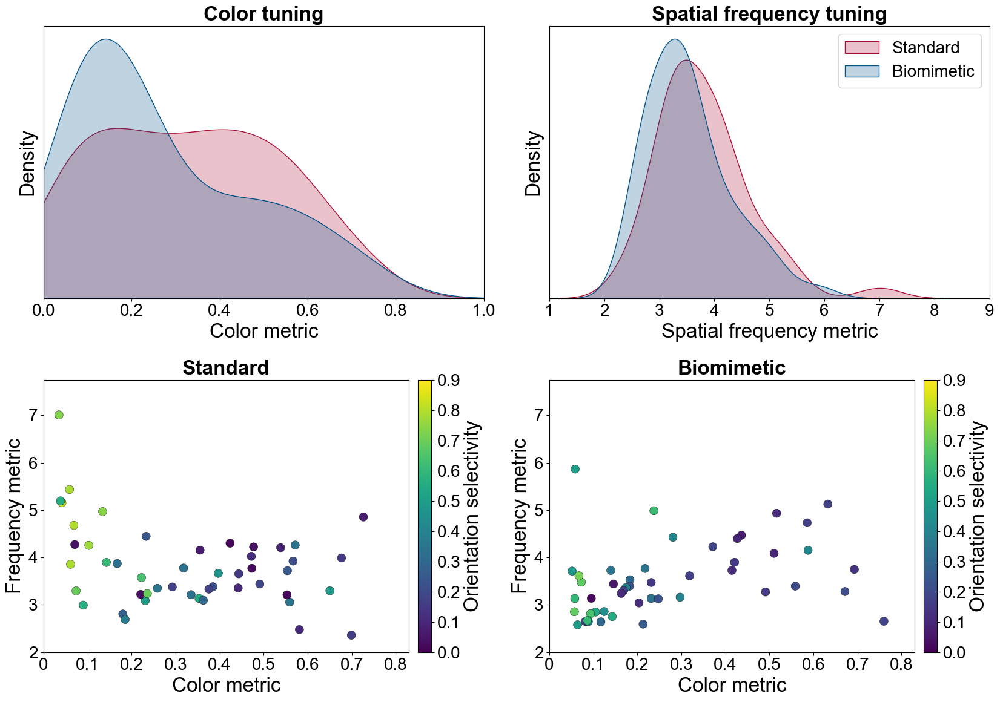

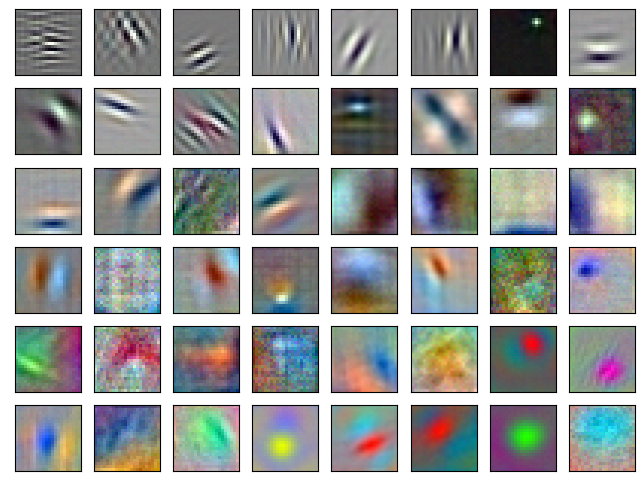

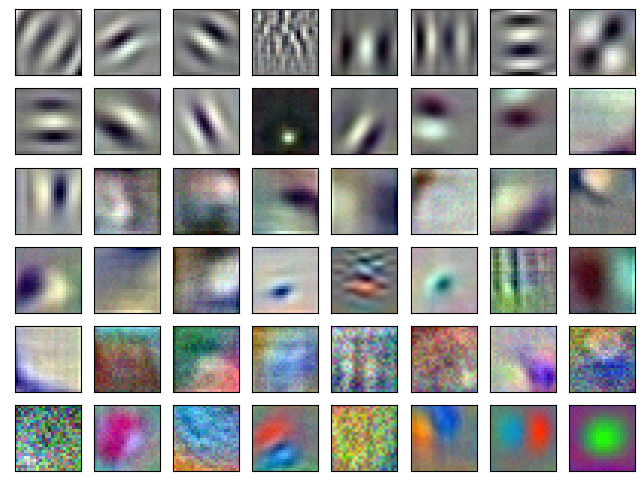

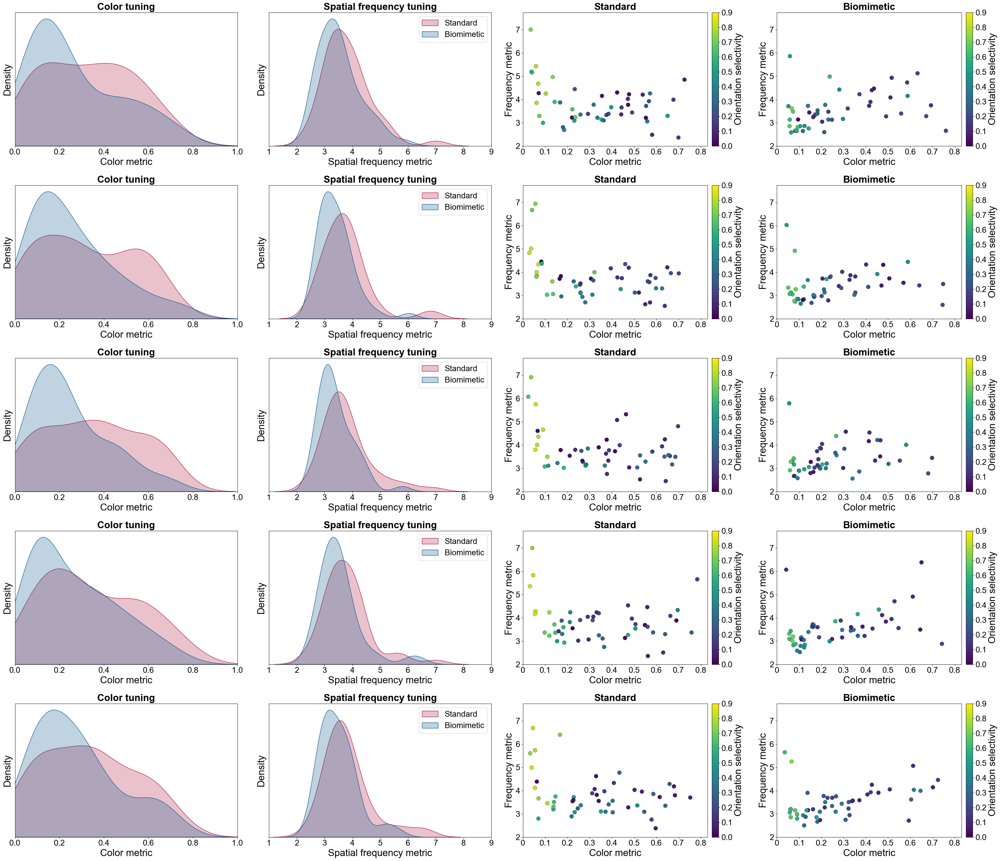

In [17]:
regimen_list = ["c0-100", "g4-050_c0-050"]
regimen_names = ["Standard", "Biomimetic"]

model_name = "alexnet22_48"
train_version = 0
num_columns = 8

figure_path = os.path.join(FIGURE_PATH, model_name, str(train_version))
if not os.path.exists(figure_path):
    os.makedirs(figure_path)
color_ind_all = []
fftfreq_ind_all = []
fftaz_ind_all = []
for repeat in range(5):
    color_ind, fftfreq_ind, fftaz_ind, weights = get_rf_indices(model_name, train_version, repeat, regimen_list)
    if repeat == 0:
        create_rf_plot_merged_2x2(regimen_names, color_ind, fftfreq_ind, fftaz_ind, 
                                  os.path.join(figure_path, "RF_stats_plot_100epochs_repeat_0_2x2.png"), 
                                  freq_xlim=(1, 9), freq_range2=(2, 7.75), col_max=0.83)
        for i, regimen in enumerate(regimen_list):
            visualize_rf(weights[i], color_ind[i], num_columns, os.path.join(figure_path, "RF_" + regimen + "_repeat_0.png"))
    color_ind_all.append(color_ind)
    fftfreq_ind_all.append(fftfreq_ind)
    fftaz_ind_all.append(fftaz_ind)
    
create_rf_plot_merged_repeats(regimen_names, color_ind_all, fftfreq_ind_all, fftaz_ind_all, 
                              os.path.join(figure_path, "RF_stats_plot_100epochs_all_repeats_merged.png"), 
                              freq_xlim=(1, 9), freq_range2=(2, 7.75), col_max=0.83)

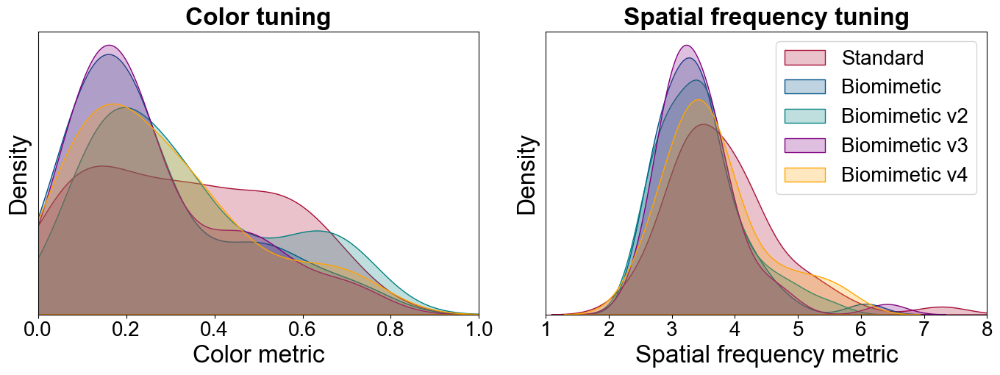

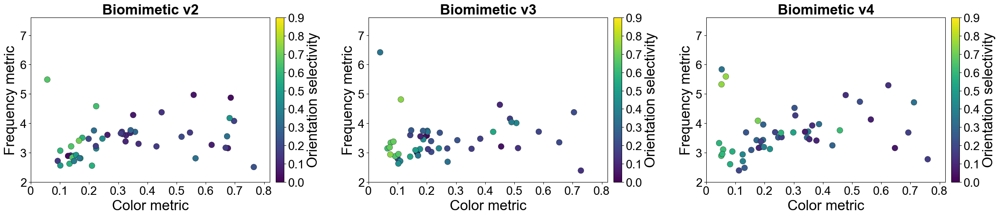

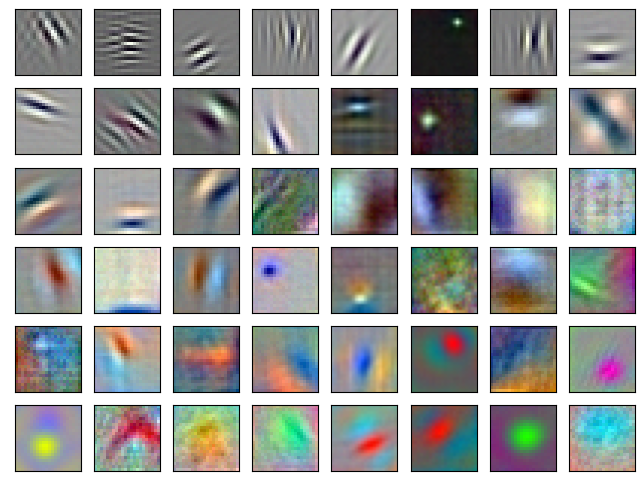

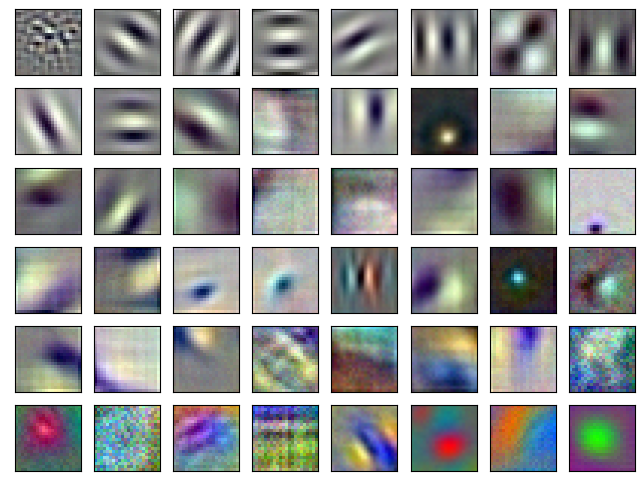

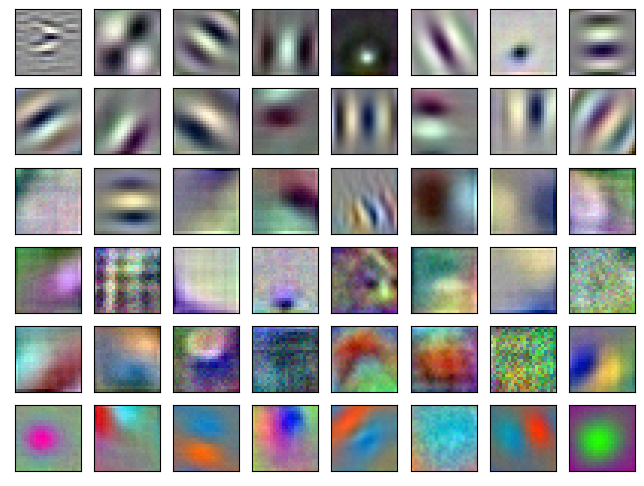

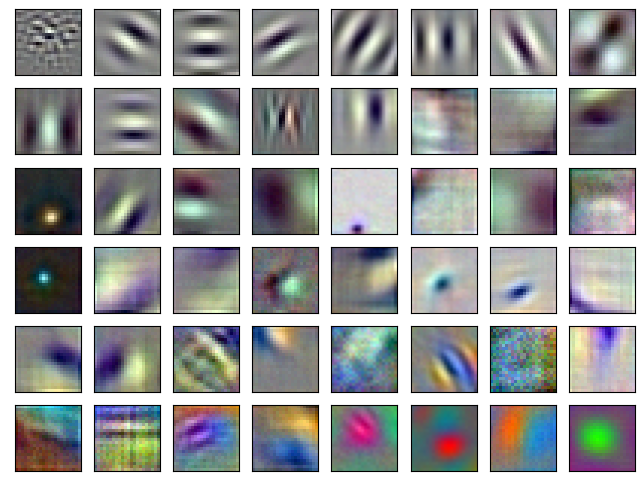

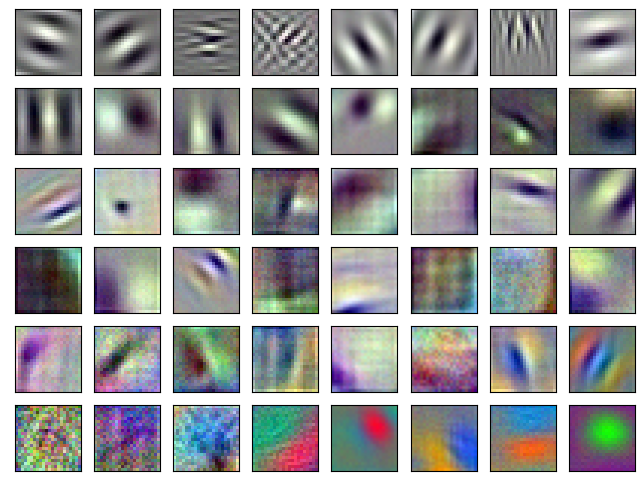

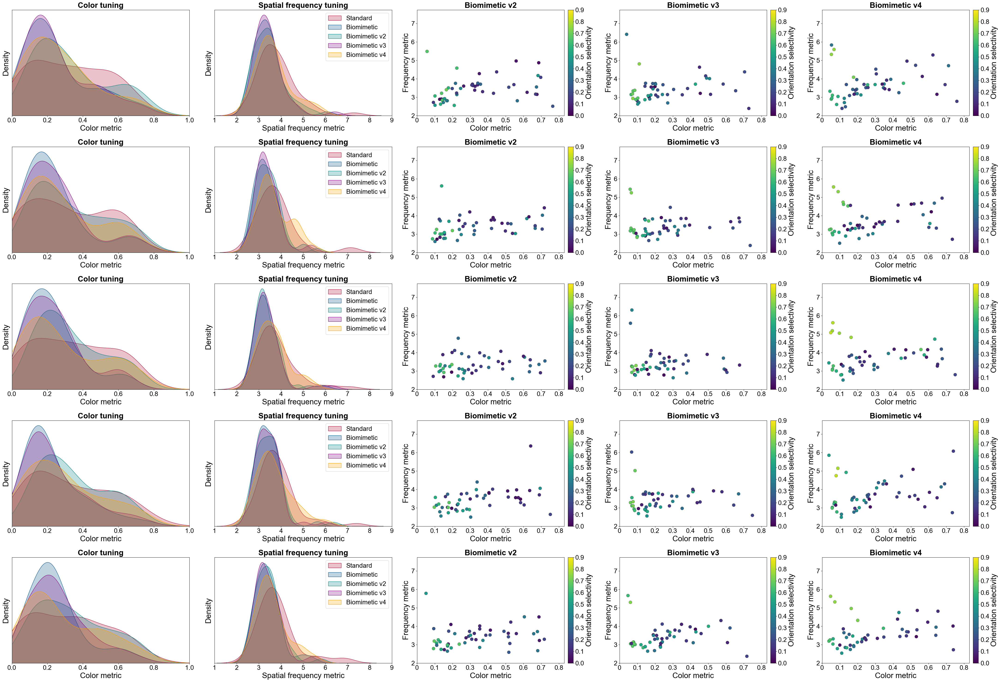

In [20]:
regimen_list_1 = ["c0-100_c0-100", "g4-100_c0-100", "g4-050_c4-050_c0-100", "g4-100_c0-100_c0-100"]
regimen_list_2 = ["g4-100_c0-100"]
regimen_names = ["Standard", "Biomimetic", "Biomimetic v2", "Biomimetic v3", "Biomimetic v4"]

model_name = "alexnet22_48"
train_version = 0
num_columns = 8

figure_path = os.path.join(FIGURE_PATH, model_name, str(train_version))
if not os.path.exists(figure_path):
    os.makedirs(figure_path)

figure_path_2 = os.path.join(FIGURE_PATH, "alexnet22_48_half", str(train_version))
if not os.path.exists(figure_path_2):
    os.makedirs(figure_path_2)

color_ind_all = []
fftfreq_ind_all = []
fftaz_ind_all = []
for repeat in range(5):
    color_ind, fftfreq_ind, fftaz_ind, weights = get_rf_indices(model_name, train_version, repeat, regimen_list_1)
    color_ind_v4, fftfreq_ind_v4, fftaz_ind_v4, weights_v4 = get_rf_indices("alexnet22_48_half", train_version, repeat, regimen_list_2)
    color_ind = np.concatenate([color_ind, color_ind_v4])
    fftfreq_ind = np.concatenate([fftfreq_ind, fftfreq_ind_v4])
    fftaz_ind = np.concatenate([fftaz_ind, fftaz_ind_v4])
    weights = np.concatenate([weights, weights_v4])
    if repeat == 0:
        create_rf_density_plot(regimen_names, color_ind, fftfreq_ind, os.path.join(figure_path, "RF_density_plot_v2-v4_repeat_0.png"))
        create_rf_scatterplot(regimen_names[2:], color_ind[2:], fftfreq_ind[2:], fftaz_ind[2:], 
                              os.path.join(figure_path, "RF_scatterplot_v2-v4_repeat_0.png"))
        for i, regimen in enumerate(regimen_list_1):
            visualize_rf(weights[i], color_ind[i], num_columns, os.path.join(figure_path, "RF_" + regimen + "_repeat_0.png"))
        visualize_rf(weights[-1], color_ind[-1], num_columns, os.path.join(figure_path_2, "RF_" + regimen_list_2[0] + "_repeat_0.png"))
    color_ind_all.append(color_ind)
    fftfreq_ind_all.append(fftfreq_ind)
    fftaz_ind_all.append(fftaz_ind)
    
create_rf_plot_merged_repeats(regimen_names, color_ind_all, fftfreq_ind_all, fftaz_ind_all, 
                              os.path.join(figure_path, "RF_stats_plot_v2-v4_all_repeats_merged.png"), 
                              freq_xlim=(1, 9), freq_range2=(2, 7.75), col_max=0.83, scatter_plot_index=2)

## Texture-shape plots

alexnet22 0 96
Standard: 0.5608333333333333
Biomimetic: 0.5795


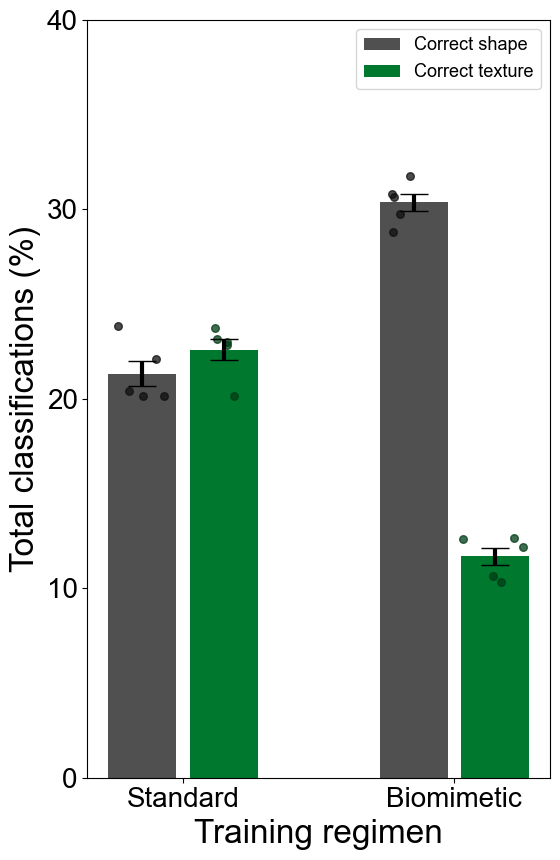

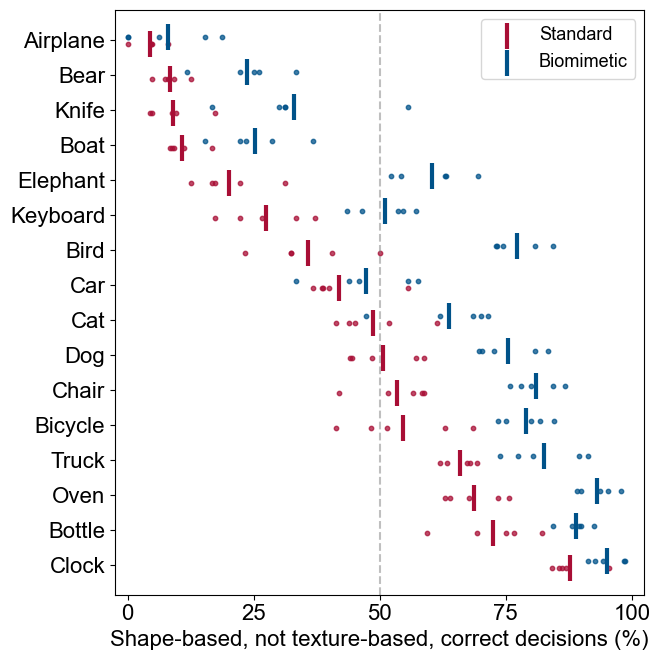

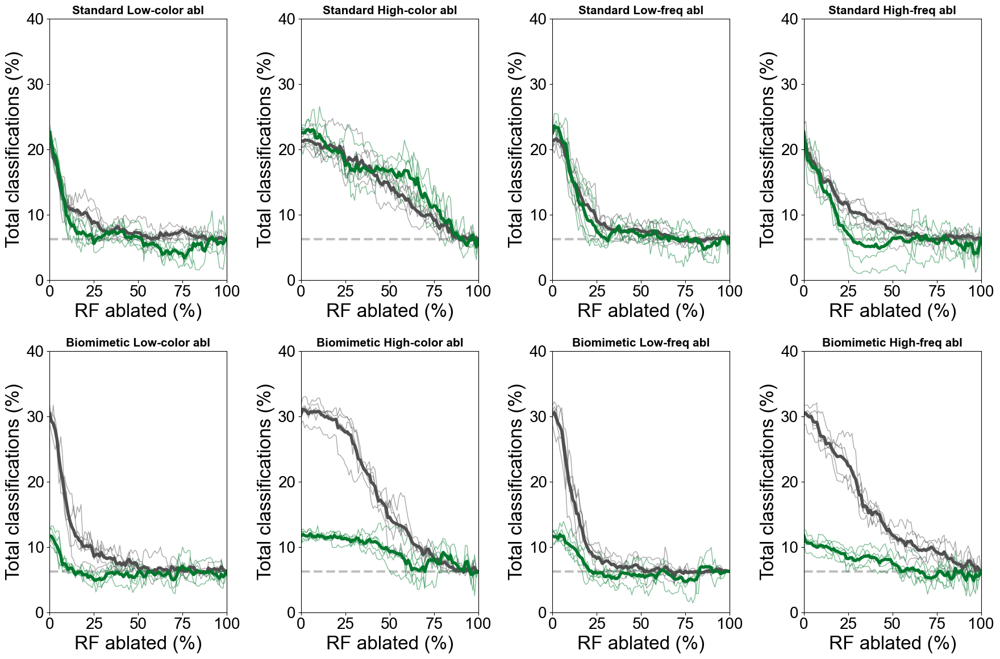

alexnet 0 96
Standard: 0.5493333333333333
Biomimetic: 0.5810000000000001


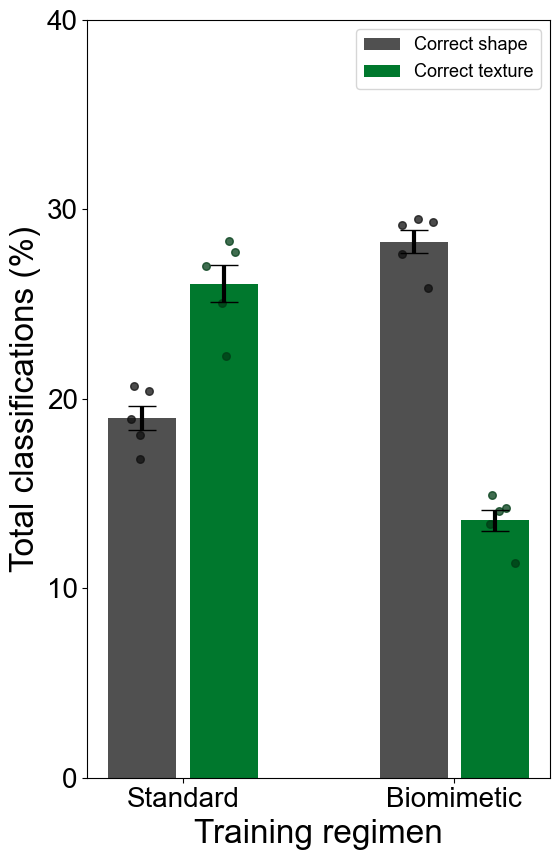

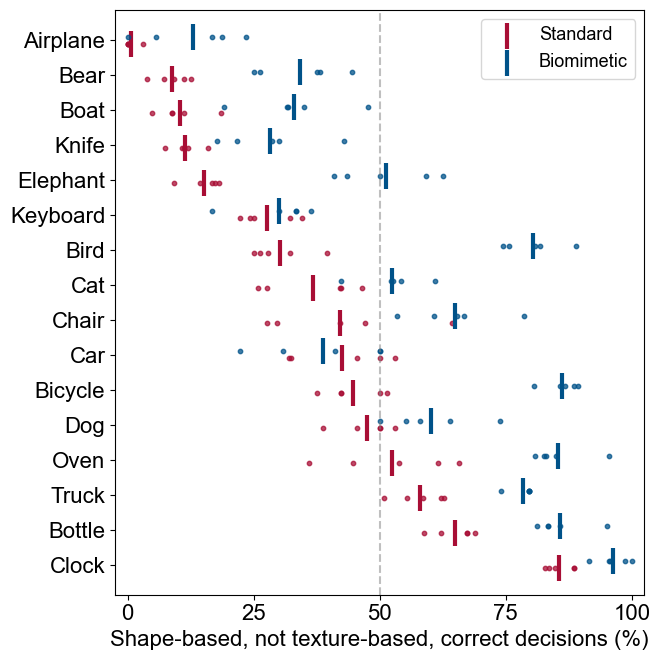

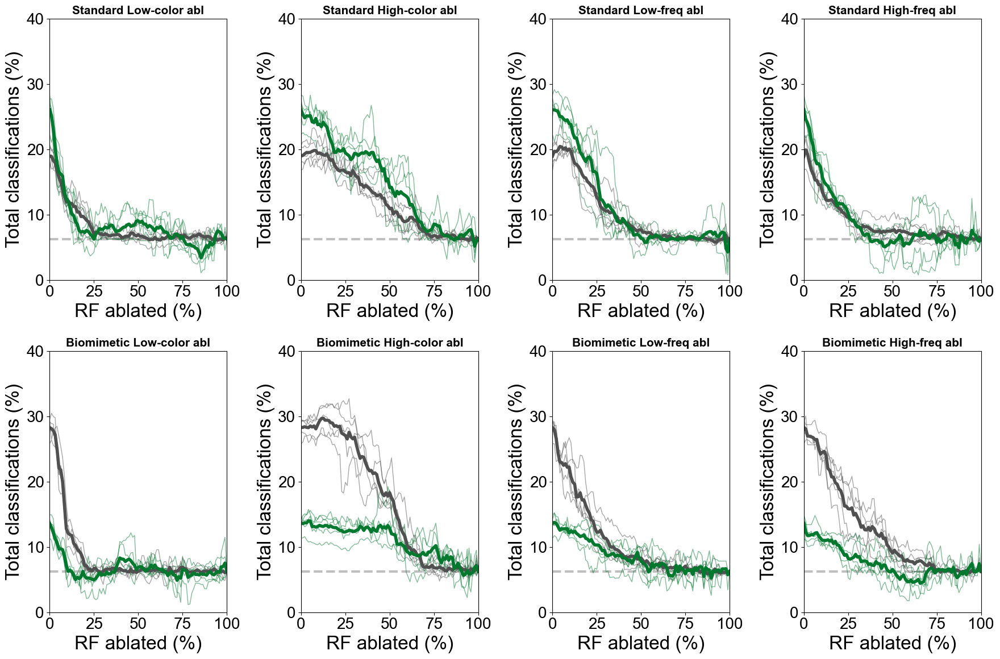

alexnet22_48 1 48
Standard: 0.5893333333333335
Biomimetic: 0.5898333333333333


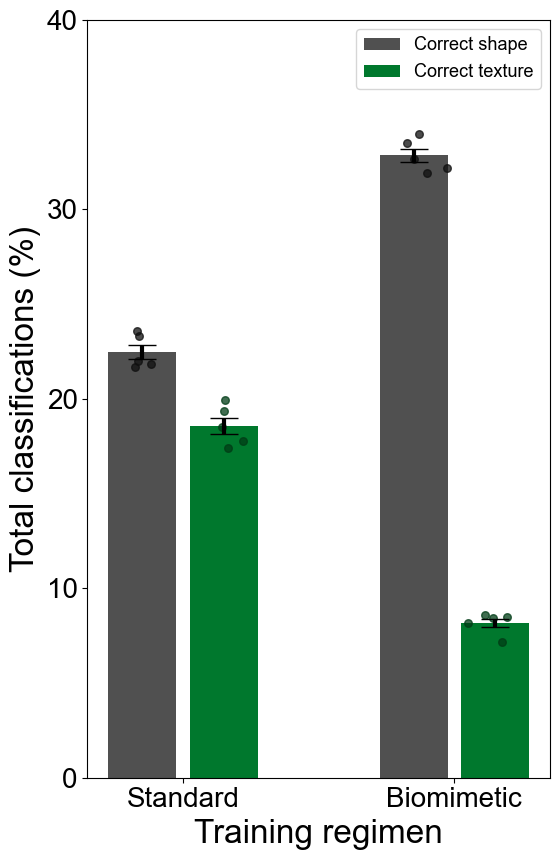

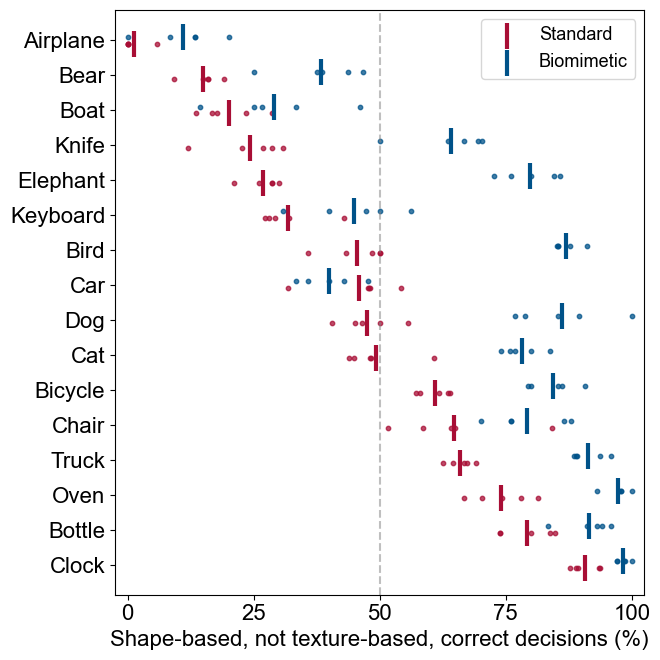

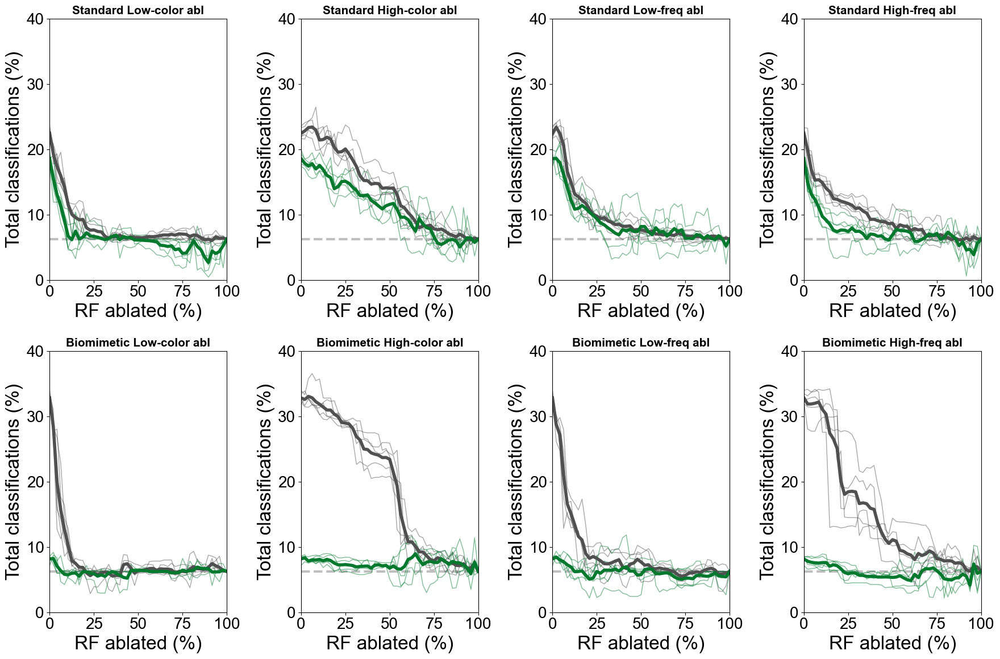

In [21]:
figsize = (6, 9)

for model_name, train_version, num_max_ablations in [("alexnet22", 0, 96), ("alexnet", 0, 96), ("alexnet22_48", 1, 48)]:
    print(model_name, train_version, num_max_ablations)
    
    figure_path = os.path.join(FIGURE_PATH, model_name, str(train_version))
    if not os.path.exists(figure_path):
        os.makedirs(figure_path)

    regimen_list = ["c0-100_c0-100", "g4-100_c0-100"]
    regimen_names = ["Standard", "Biomimetic"]

    res_pd_all = [] 
    for i in range(5):
        res_pd_all.append(pd.read_csv(os.path.join(RESULT_PATH, model_name, str(train_version), str(i), "texture_ablation.csv"), index_col=0))

    create_texture_shape_barplot(regimen_list, regimen_names, res_pd_all, os.path.join(figure_path, "texture_shape_bar.png"), figsize=figsize)
    create_texture_shape_scatterplot(regimen_list, regimen_names, colors, res_pd_all, os.path.join(figure_path, "texture_shape_scatter.png"))
    create_texture_shape_ablation_plot(regimen_list, regimen_names, res_pd_all, num_max_ablations, os.path.join(figure_path, "texture_shape_ablation.png"))

Standard: 0.5673333333333334
Biomimetic: 0.5831666666666666


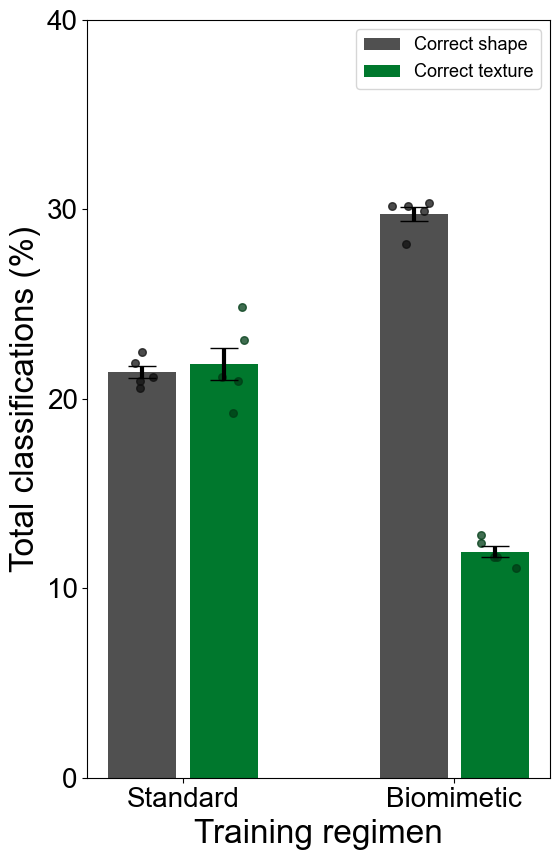

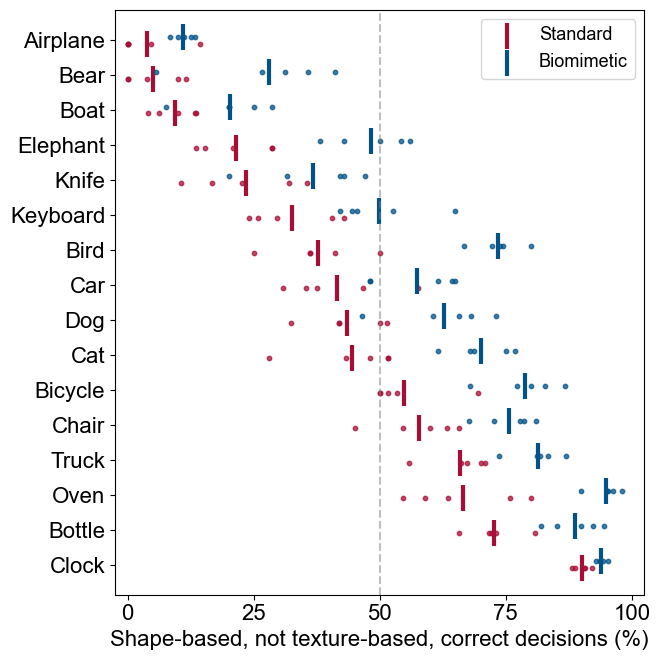

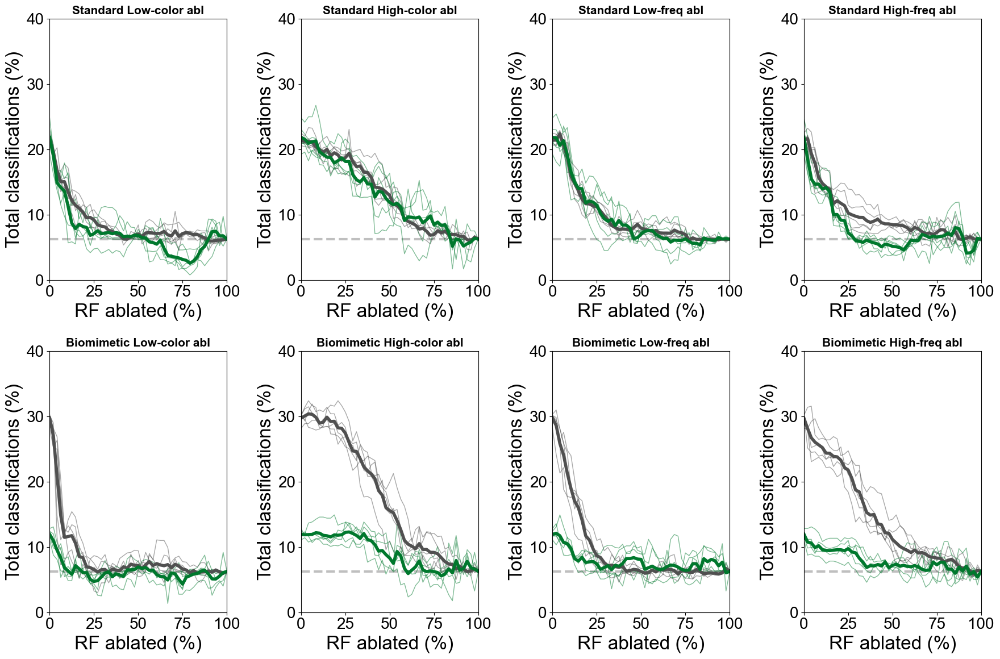

In [22]:
model_name = "alexnet22_48"
train_version = 0

figure_path = os.path.join(FIGURE_PATH, model_name, str(train_version))
if not os.path.exists(figure_path):
    os.makedirs(figure_path)

regimen_list = ["c0-100", "g4-050_c0-050"]
regimen_names = ["Standard", "Biomimetic"]

figsize = (6, 9)

res_pd_all = [] 
for i in range(5):
    res_pd_all.append(pd.read_csv(os.path.join(RESULT_PATH, model_name, str(train_version), str(i), "texture_ablation.csv"), index_col=0))

create_texture_shape_barplot(regimen_list, regimen_names, res_pd_all, os.path.join(figure_path, "texture_shape_bar_100epochs.png"), figsize=figsize)
create_texture_shape_scatterplot(regimen_list, regimen_names, colors, res_pd_all, os.path.join(figure_path, "texture_shape_scatter_100epochs.png"))
create_texture_shape_ablation_plot(regimen_list, regimen_names, res_pd_all, num_max_ablations, os.path.join(figure_path, "texture_shape_ablation_100epochs.png"))

Standard: 0.5688333333333333
Biomimetic: 0.5894999999999999
Biomimetic
v2: 0.5931666666666666
Biomimetic
v3: 0.5831666666666667
Biomimetic
v4: 0.5793333333333334


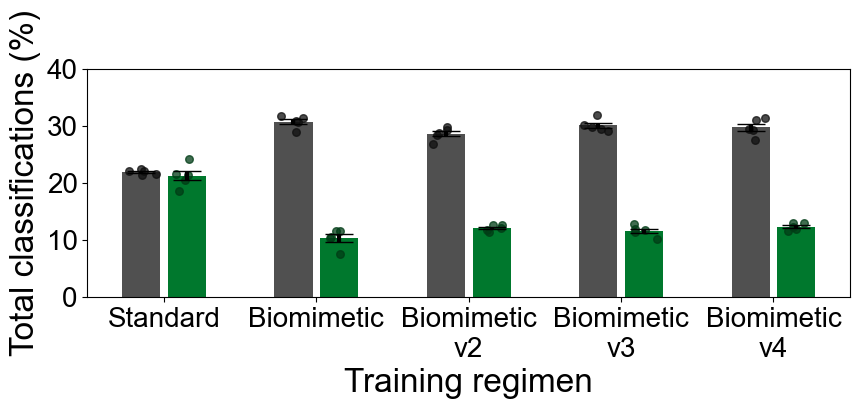

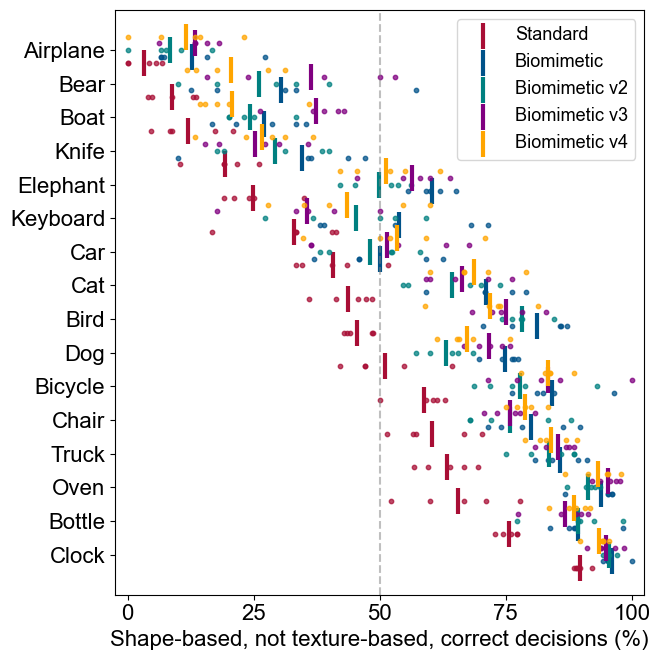

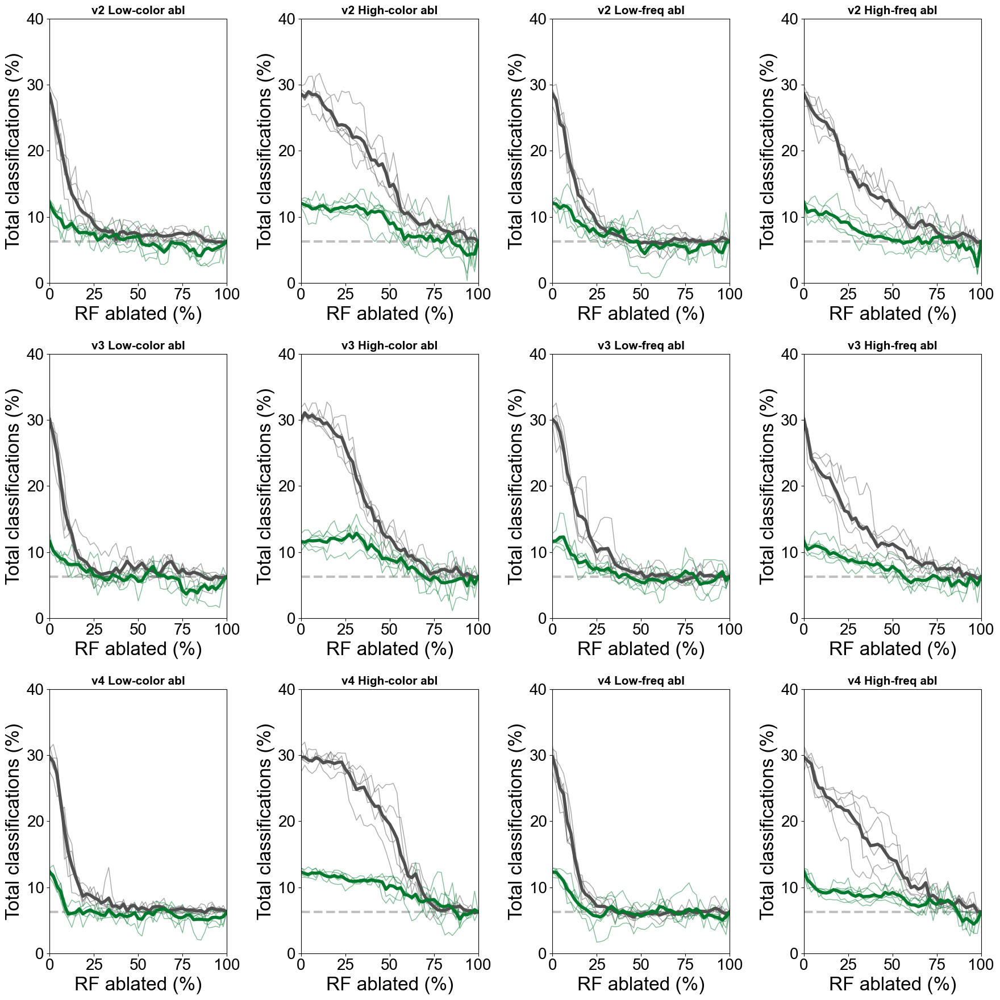

In [23]:
model_name = "alexnet22_48"
train_version = 0

figure_path = os.path.join(FIGURE_PATH, model_name, str(train_version))
if not os.path.exists(figure_path):
    os.makedirs(figure_path)

num_max_ablations = 48

regimen_list = ["c0-100_c0-100", "g4-100_c0-100", "g4-050_c4-050_c0-100", "g4-100_c0-100_c0-100", "g4-100_c0-100"]
regimen_names = ["Standard", "Biomimetic", "Biomimetic\nv2", "Biomimetic\nv3", "Biomimetic\nv4"]

res_pd_all = []
for i in range(5):
    res_pd_all.append(pd.read_csv(os.path.join(RESULT_PATH, model_name, str(train_version), str(i), "texture_ablation.csv"), index_col=0))

res_pd_all_2 = []
for i in range(5):
    res_pd_all_2.append(pd.read_csv(os.path.join(RESULT_PATH, "alexnet22_48_half", str(train_version), str(i), "texture_ablation.csv"), 
                                    index_col=0))

create_texture_shape_barplot(regimen_list, regimen_names, res_pd_all, 
                             os.path.join(figure_path, "texture_shape_bar_v2-v4.png"), 
                             figsize=(9, 4), legend=False, res_pd_all_2=res_pd_all_2)

regimen_names = ["Standard", "Biomimetic", "Biomimetic v2", "Biomimetic v3", "Biomimetic v4"]
create_texture_shape_scatterplot(regimen_list, regimen_names, colors, res_pd_all, 
                                 os.path.join(figure_path, "texture_shape_scatter_v2-v4.png"), res_pd_all_2=res_pd_all_2)

regimen_list = ["g4-050_c4-050_c0-100", "g4-100_c0-100_c0-100", "g4-100_c0-100"]
regimen_names = ["v2", "v3", "v4"]
create_texture_shape_ablation_plot(regimen_list, regimen_names, res_pd_all, 48, 
                                   os.path.join(figure_path, "texture_shape_ablation_v2-v4.png"), res_pd_all_2=res_pd_all_2)